<div>
    <table>
    <tr>
        <th style="text-align: center;">Project</th>
        <td style="text-align: center; width: 200px">CO2 Emissions</td>
        <td colspan="3" rowspan="3" style="text-align: center; width: 200px"><h1>Third Step - Modelling (Regression)</h1></td>
    </tr>
    <tr>
        <th style="text-align: center;">Location</th>
        <td style="text-align: center; width: 200px">-</td>
    </tr>
    <tr>
        <th style="text-align: center;">Date</th>
        <td style="text-align: center; width: 200px">19-Jun-2024</td>
    </tr>
    <tr>
        <th style="text-align: center;">&nbsp;</th>
        <td style="text-align: center; width: 200px">&nbsp;</td>
        <td style="text-align: center; width: 200px">&nbsp;</td>
        <td style="text-align: center; width: 200px">&nbsp;</td>
        <td style="text-align: center; width: 200px">&nbsp;</td>
    </tr>
    <tr>
        <th style="text-align: center;">COHORD:</th>
        <td style="text-align: center; width: 200px">C. ARNAUD</td>
        <td style="text-align: center; width: 200px">&nbsp;</td>
        <td style="text-align: center; width: 200px">&nbsp;</td>
        <td style="text-align: center; width: 200px">&nbsp;</td>
    </tr>
    <tr>
        <th style="text-align: center;">&nbsp;</th>
        <td style="text-align: center;">D. GOMES-OCHOA</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
    </tr>
    <tr>
        <th style="text-align: center;">&nbsp;</th>
        <td style="text-align: center;">P. DESHPANDE</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
    </tr>
    <tr>
        <th style="text-align: center;">&nbsp;</th>
        <td style="text-align: center;">R. MARINHO</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
    </tr>
    <tr>
        <th style="text-align: center;">&nbsp;</th>
        <td style="text-align: center;">S. MASOOD</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
        <td style="text-align: center;">&nbsp;</td>
    </tr>
    </table>
</div>

# 1. Purpose

> The purpose of this Calculation note is to perform different regressions methods to try to estimate the CO2 emissions
> based on the available caracteristics present on the dataset obtained in the pre-processing part of this report.
>
> The main objectives are:
>
> - Obtain a regression model that can estimate the CO2 emissions from vehicles caracteristics
> - Compare different methods and propose improvments for low performing estimation models
> - Select the best regression model for this dataset
> 

# 2. Imports

In [1]:
import sys
import os
from pathlib import Path
sys.path.append(str(Path.cwd().parent.parent))
from co2emissions.config import data_dir

import pandas as pd

In [4]:
import warnings 
warnings.filterwarnings('ignore') # Ignore undesired warnigs

import numpy as np
import pandas as pd

from sklearn import model_selection, preprocessing

from sklearn.preprocessing import MinMaxScaler, RobustScaler, StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV, KFold, cross_val_score
from sklearn.linear_model import LinearRegression, RidgeCV, ElasticNetCV, Lasso, lasso_path, LassoCV

from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

import matplotlib.pyplot as plt
%matplotlib inline 

import seaborn as sns
import scipy.stats as stats
#import  statsmodels.api as sm
#import statsmodels.stats.api as sms

import plotly.express as px
import plotly.graph_objects as go 
from plotly.subplots import make_subplots

plt.rcParams['figure.dpi'] = 120 # Better image quality in matplotlib plots

# 3. Initial Dataset

> The initial data set is the one obtained in the pre-processing pahse of this project.

In [5]:
df_path = os.path.join(data_dir, '2-cleaned', 'data_phase_2.csv')
df = pd.read_csv(df_path)
df.head(3)

,lib_mrq_utac,cod_cbr,hybride,puiss_max,conso_mixte,co2,co_typ_1,hc,nox,hcnox,masse_ordma_max,year,type_of_gearbox,nbr_reports
0,ALFA ROMEO,ES,non,147.0,7.8,182.0,0.647,0.052,0.032,0.084,1505.0,2015,M,6
1,ALFA ROMEO,GO,non,125.0,5.1,136.0,0.192,0.021,0.169,0.190,1565.0,2015,M,6
2,ALFA ROMEO,GO,non,100.0,5.1,134.0,0.066,0.026,0.149,0.175,1565.0,2015,M,6


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103248 entries, 0 to 103247
Data columns (total 14 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   lib_mrq_utac     103248 non-null  object 
 1   cod_cbr          103248 non-null  object 
 2   hybride          103248 non-null  object 
 3   puiss_max        103248 non-null  float64
 4   conso_mixte      103248 non-null  float64
 5   co2              103248 non-null  float64
 6   co_typ_1         103248 non-null  float64
 7   hc               103248 non-null  float64
 8   nox              103248 non-null  float64
 9   hcnox            103248 non-null  float64
 10  masse_ordma_max  103248 non-null  float64
 11  year             103248 non-null  int64  
 12  type_of_gearbox  103248 non-null  object 
 13  nbr_reports      103248 non-null  object 
dtypes: float64(8), int64(1), object(5)
memory usage: 11.0+ MB


In [4]:
df.year.value_counts() / len(df)

year
2014    0.462314
2013    0.321391
2015    0.189883
2012    0.026412
Name: count, dtype: float64

> 2015 is around 20% of the dataset, we will later use the data of this year for test and the remaining data for trainning.

In [5]:
# Order by year for later
df = df.sort_values(by='year').reset_index()

# 4. Separation of Variables

In [6]:
num_vars = df[['puiss_max', 'conso_mixte', 'co2', 'co_typ_1', 'hc', 'nox', 'hcnox', 'masse_ordma_max']]

qlt_vars = df[['cod_cbr', 'hybride', 'type_of_gearbox', 'nbr_reports']]
qlt_vars = pd.get_dummies(qlt_vars, dtype='int64')

display(num_vars.head(3))
display(qlt_vars.head(3))

display(qlt_vars.shape)

,puiss_max,conso_mixte,co2,co_typ_1,hc,nox,hcnox,masse_ordma_max
0,139.0,5.7,149.0,0.403,0.036,0.175,0.211,1505.0
1,100.0,5.0,133.0,0.200,0.016,0.159,0.175,1615.0
2,100.0,4.9,130.0,0.200,0.016,0.159,0.175,1615.0


,cod_cbr_EE,cod_cbr_EH,cod_cbr_ES,cod_cbr_ES/GP,cod_cbr_FE,cod_cbr_GH,cod_cbr_GL,cod_cbr_GN,cod_cbr_GN/ES,cod_cbr_GO,...,nbr_reports_7,nbr_reports_8,nbr_reports_.,nbr_reports_0,nbr_reports_4,nbr_reports_5,nbr_reports_6,nbr_reports_7,nbr_reports_8,nbr_reports_9
0,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0


(103248, 31)

In [7]:
all_vars = num_vars.join(qlt_vars)
all_vars.head(3)

,puiss_max,conso_mixte,co2,co_typ_1,hc,nox,hcnox,masse_ordma_max,cod_cbr_EE,cod_cbr_EH,...,nbr_reports_7,nbr_reports_8,nbr_reports_.,nbr_reports_0,nbr_reports_4,nbr_reports_5,nbr_reports_6,nbr_reports_7,nbr_reports_8,nbr_reports_9
0,139.0,5.7,149.0,0.403,0.036,0.175,0.211,1505.0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,100.0,5.0,133.0,0.200,0.016,0.159,0.175,1615.0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,100.0,4.9,130.0,0.200,0.016,0.159,0.175,1615.0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [8]:
data = all_vars.drop('co2', axis=1)
target = all_vars.co2

In [9]:
data.shape

(103248, 38)

# 5. Train / Test Split by year

> The Test / Train split is done considering the complete year 2015 as the test set. Therefore, the years 2012 until 2014 are included in the train set
> Additionnaly, the year 2015 represents 19% of the overall dataset which is perfect for our use.

In [10]:
X_train = data[~(df.year==2015)]    # Use < 2015 for train
y_train = target[~(df.year==2015)]  # Use < 2015 for train

X_test = data[df.year==2015]        # Use 2015 for test
y_test = target[df.year==2015]      # Use 2015 for test

In [11]:
# Quick check
print(f'{len(X_train) / len(df) = :.3f}')
print(f'{len(X_test)  / len(df) = :.3f}') 
print(f'{len(y_train) / len(df) = :.3f}')
print(f'{len(y_test)  / len(df) = :.3f}') 

len(X_train) / len(df) = 0.810
len(X_test)  / len(df) = 0.190
len(y_train) / len(df) = 0.810
len(y_test)  / len(df) = 0.190


In [12]:
scaler = StandardScaler()
scaler.fit(X_train)

X_train = pd.DataFrame(scaler.transform(X_train))
X_train.columns = data.columns
X_test = pd.DataFrame(scaler.transform(X_test))
X_test.columns = data.columns

display(X_train.head(3))
display(X_test.head(3))

,puiss_max,conso_mixte,co_typ_1,hc,nox,hcnox,masse_ordma_max,cod_cbr_EE,cod_cbr_EH,cod_cbr_ES,...,nbr_reports_7,nbr_reports_8,nbr_reports_.,nbr_reports_0,nbr_reports_4,nbr_reports_5,nbr_reports_6,nbr_reports_7,nbr_reports_8,nbr_reports_9
0,0.395724,-1.355987,1.514404,0.847903,-0.325240,-0.302596,-1.737433,-0.012939,-0.065563,-0.35249,...,-0.295878,-0.075253,-0.00489,-0.061091,-0.016585,-0.414803,-0.678547,-0.288065,-0.077704,-0.02046
1,-0.442641,-1.823471,0.127719,-0.542210,-0.359061,-0.379491,-1.490360,-0.012939,-0.065563,-0.35249,...,-0.295878,-0.075253,-0.00489,-0.061091,-0.016585,-0.414803,-0.678547,-0.288065,-0.077704,-0.02046
2,-0.442641,-1.890254,0.127719,-0.542210,-0.359061,-0.379491,-1.490360,-0.012939,-0.065563,-0.35249,...,-0.295878,-0.075253,-0.00489,-0.061091,-0.016585,-0.414803,-0.678547,-0.288065,-0.077704,-0.02046


,puiss_max,conso_mixte,co_typ_1,hc,nox,hcnox,masse_ordma_max,cod_cbr_EE,cod_cbr_EH,cod_cbr_ES,...,nbr_reports_7,nbr_reports_8,nbr_reports_.,nbr_reports_0,nbr_reports_4,nbr_reports_5,nbr_reports_6,nbr_reports_7,nbr_reports_8,nbr_reports_9
0,0.094773,-2.224172,0.004761,-0.750727,-0.576786,-0.605904,-1.591435,-0.012939,-0.065563,-0.35249,...,-0.295878,-0.075253,-0.00489,-0.061091,-0.016585,-0.414803,-0.678547,3.471436,-0.077704,-0.02046
1,0.094773,-2.224172,0.004761,-0.750727,-0.576786,-0.605904,-1.591435,-0.012939,-0.065563,-0.35249,...,-0.295878,-0.075253,-0.00489,-0.061091,-0.016585,-0.414803,-0.678547,3.471436,-0.077704,-0.02046
2,0.094773,-2.290955,0.004761,-0.750727,-0.576786,-0.605904,-1.591435,-0.012939,-0.065563,-0.35249,...,-0.295878,-0.075253,-0.00489,-0.061091,-0.016585,-0.414803,-0.678547,3.471436,-0.077704,-0.02046


# 6. Linear Regression

## 6.1 First attempt considering the StandardScaler

In [13]:
lr = LinearRegression()
lr.fit(X_train, y_train)

# Display R2
print(f'Score train : {lr.score(X_train, y_train):.4f}')
print(f'Score test  : {lr.score(X_test, y_test):.4f}')

Score train : 0.9953
Score test  : -1517793127213613973504.0000


<div class="alert alert-block alert-warning">
<i style="font-size:12px" class="fa">&#xf05a;</i> Clearly Overfitting!
</div>

In [14]:
coef = pd.DataFrame(
    lr.coef_
)
coef['Var'] = X_train.columns
coef = coef[['Var', 0]]
print(coef.to_markdown())

|    | Var               |             0 |
|---:|:------------------|--------------:|
|  0 | puiss_max         |  -0.980279    |
|  1 | conso_mixte       |  36.7504      |
|  2 | co_typ_1          |  -0.629964    |
|  3 | hc                |   1.1934      |
|  4 | nox               |  21.3761      |
|  5 | hcnox             | -20.8638      |
|  6 | masse_ordma_max   |   1.17829     |
|  7 | cod_cbr_EE        |   8.19501e+10 |
|  8 | cod_cbr_EH        |   4.13554e+11 |
|  9 | cod_cbr_ES        |  -2.17575e+12 |
| 10 | cod_cbr_ES/GP     |  -2.09083e+11 |
| 11 | cod_cbr_FE        |  -1.91882e+11 |
| 12 | cod_cbr_GH        |   2.54295e+11 |
| 13 | cod_cbr_GL        |   3.09764e+10 |
| 14 | cod_cbr_GN        |  -1.97783e+11 |
| 15 | cod_cbr_GN/ES     |  -1.33571e+11 |
| 16 | cod_cbr_GO        |  -2.25067e+12 |
| 17 | hybride_non       |   5.19472e+11 |
| 18 | hybride_oui       |  -5.12887e+11 |
| 19 | type_of_gearbox_A |  -6.98313e+11 |
| 20 | type_of_gearbox_D |  -5.186e+10   |
| 21 | type

In [15]:
predicted = lr.predict(X_test)

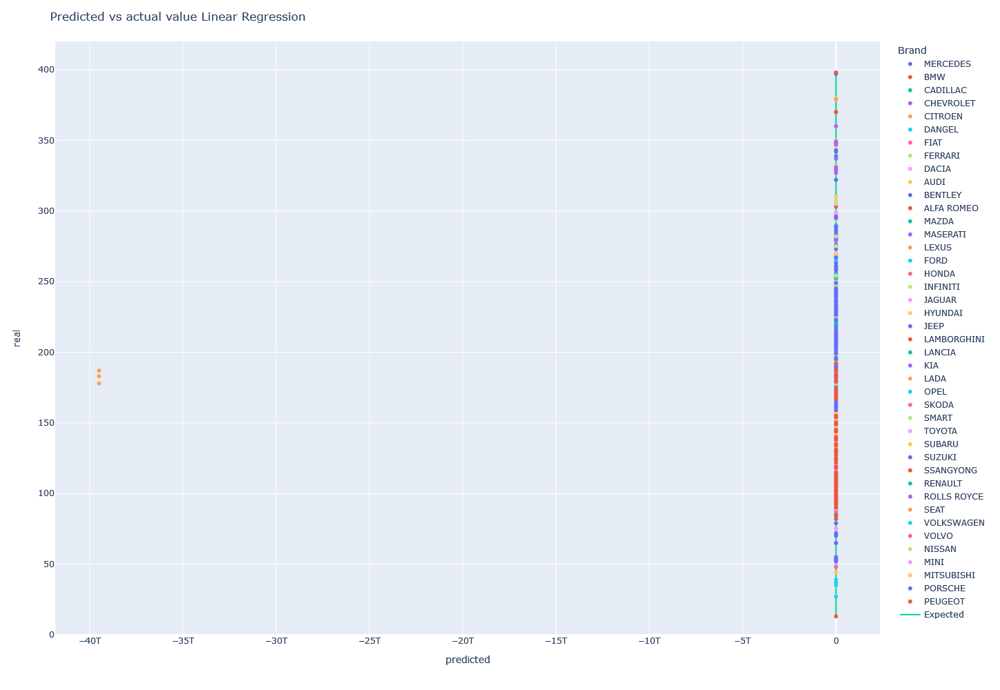

In [16]:
fig = px.scatter(
    x=predicted, 
    y=y_test,
    hover_name=df['lib_mrq_utac'][df.year==2015],
    color=df['lib_mrq_utac'][df.year==2015],
    labels={
        'x':'predicted',
        'y':'real',
        'color':'Brand'
    }
)

fig.update_layout(
    title='Predicted vs actual value Linear Regression',
    height=1000,
)

fig.add_scatter(
    x = [y_test.min(), y_test.max()],
    y = [y_test.min(), y_test.max()],
    name = 'Expected',
    mode = 'lines'
)

# Y axis scale
fig['layout']['yaxis']['range']=[0,420]

fig.show()
fig.write_image('imgs/0-Linear Regression.svg', width=1600, height=1000)

> It is not clear the reason why it is not performing well for separation by year.
>
> There is two possibilities to solve this problem:
> - Considering a new scaler to normalized our data (i.e. RobustScaler in our case)
> - Use of Regularized Linear Regression to remove some variables

## 6.2 Second attempt considering the RobustScaler

In [17]:
# Normalization of the data using RobustScaler
X_train_robust = data[~(df.year==2015)]    # Use < 2015 for train
X_test_robust = data[df.year==2015]        # Use 2015 for test

scaler_robust = RobustScaler()
scaler_robust.fit(X_train_robust)

X_train_robust = pd.DataFrame(scaler_robust.transform(X_train_robust))
X_test_robust = pd.DataFrame(scaler_robust.transform(X_test_robust))

display(X_train_robust.head(3))
display(X_test_robust.head(3))

,0,1,2,3,4,5,6,7,8,9,...,28,29,30,31,32,33,34,35,36,37
0,0.95,-2.2,1.198198,0.75,-0.975,-0.415385,-1.214511,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,-1.00,-2.9,0.283784,-0.25,-1.375,-0.969231,-1.041009,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,-1.00,-3.0,0.283784,-0.25,-1.375,-0.969231,-1.041009,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


,0,1,2,3,4,5,6,7,8,9,...,28,29,30,31,32,33,34,35,36,37
0,0.25,-3.499999,0.202703,-0.4,-3.95,-2.6,-1.111987,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.25,-3.499999,0.202703,-0.4,-3.95,-2.6,-1.111987,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.25,-3.599999,0.202703,-0.4,-3.95,-2.6,-1.111987,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [18]:
lr = LinearRegression()
lr.fit(X_train_robust, y_train)

# Display R2
print(f'Score train : {lr.score(X_train_robust, y_train):.4f}')
print(f'Score test  : {lr.score(X_test_robust, y_test):.4f}')

Score train : 0.9953
Score test  : -29816200138904276.0000


> The Problem of overfitting is solved using another scaler.

In [19]:
# Display of the coefficient of the Linear Regression
coef = pd.DataFrame(
    lr.coef_
)
coef['Var'] = X_train.columns
coef = coef[['Var', 0]]
print(coef.to_markdown())

|    | Var               |            0 |
|---:|:------------------|-------------:|
|  0 | puiss_max         | -0.422258    |
|  1 | conso_mixte       | 24.5427      |
|  2 | co_typ_1          | -0.955552    |
|  3 | hc                |  0.946455    |
|  4 | nox               |  0.395061    |
|  5 | hcnox             | -0.601695    |
|  6 | masse_ordma_max   |  1.68622     |
|  7 | cod_cbr_EE        | -5.11631e+09 |
|  8 | cod_cbr_EH        | -5.11631e+09 |
|  9 | cod_cbr_ES        |  3.23038e+09 |
| 10 | cod_cbr_ES/GP     |  3.23038e+09 |
| 11 | cod_cbr_FE        |  3.23038e+09 |
| 12 | cod_cbr_GH        | -5.11631e+09 |
| 13 | cod_cbr_GL        | -5.11631e+09 |
| 14 | cod_cbr_GN        |  3.23038e+09 |
| 15 | cod_cbr_GN/ES     |  3.23038e+09 |
| 16 | cod_cbr_GO        |  3.23038e+09 |
| 17 | hybride_non       | -4.19554e+09 |
| 18 | hybride_oui       |  4.15115e+09 |
| 19 | type_of_gearbox_A |  8.2742e+10  |
| 20 | type_of_gearbox_D |  8.2742e+10  |
| 21 | type_of_gearbox_M |  8.2742

In [20]:
# Prediction on the training and test set
y_train_pred = lr.predict(X_train_robust)
y_test_pred = lr.predict(X_test_robust)

In [21]:
# Display R2
R2_train = lr.score(X_train_robust, y_train)
R2_test = lr.score(X_test_robust, y_test)

print(f'Score train : {R2_train:.4f}')
print(f'Score test  : {R2_test:.4f}')

# Display MSE
MSE_train = mean_squared_error(y_train, y_train_pred)
MSE_test = mean_squared_error(y_test, y_test_pred)

print(f'MSE train :   {MSE_train:.2f}')
print(f'MSE test  :   {MSE_test:.2f}')

# Display RMSE
RMSE_train = mean_squared_error(y_train, y_train_pred, squared = False)
RMSE_test = mean_squared_error(y_test, y_test_pred, squared = False)

print(f'RMSE train :   {RMSE_train:.2f}')
print(f'RMSE test  :   {RMSE_test:.2f}')

# Display MAE
MAE_train = mean_absolute_error(y_train, y_train_pred)
MAE_test = mean_absolute_error(y_test, y_test_pred)

print(f'MAE train :   {MAE_train:.2f}')
print(f'MAE test  :   {MAE_test:.2f}')

# Summary Tables of the results
dic_lr= {'R2': [R2_train, R2_test], 'MAE': [MAE_train, MAE_test], 'MSE' : [MSE_train, MSE_test], 'RMSE' : [RMSE_train, RMSE_test]}
results_lr = pd.DataFrame(dic_lr, index = ['Train', 'Test'])

results_lr['R2'] = results_lr['R2'].round(decimals=4)
results_lr[['MAE', 'MSE', 'RMSE']] = results_lr[['MAE', 'MSE', 'RMSE']].round(decimals=2)

results_lr

Score train : 0.9953
Score test  : -29816200138904276.0000
MSE train :   6.43
MSE test  :   56271134375223869440.00
RMSE train :   2.54
RMSE test  :   7501408826.03
MAE train :   1.41
MAE test  :   321447953.97


,R2,MAE,MSE,RMSE
Train,9.953000e-01,1.410000e+00,6.430000e+00,2.540000e+00
Test,-2.981620e+16,3.214480e+08,5.627113e+19,7.501409e+09


> Linear Regression is based on two assumptions about errors: homo-sedasticity and normality.
> Let's study now the residues of our model to ensure the compliance of these assumptions
>
> To do that, we will represent in two different graphs:
> - The residues as a function of the target variable to have an estimate of the homoscedasticity of the residues
> - A Quantile-Quantile or (Q-Q plot) diagram

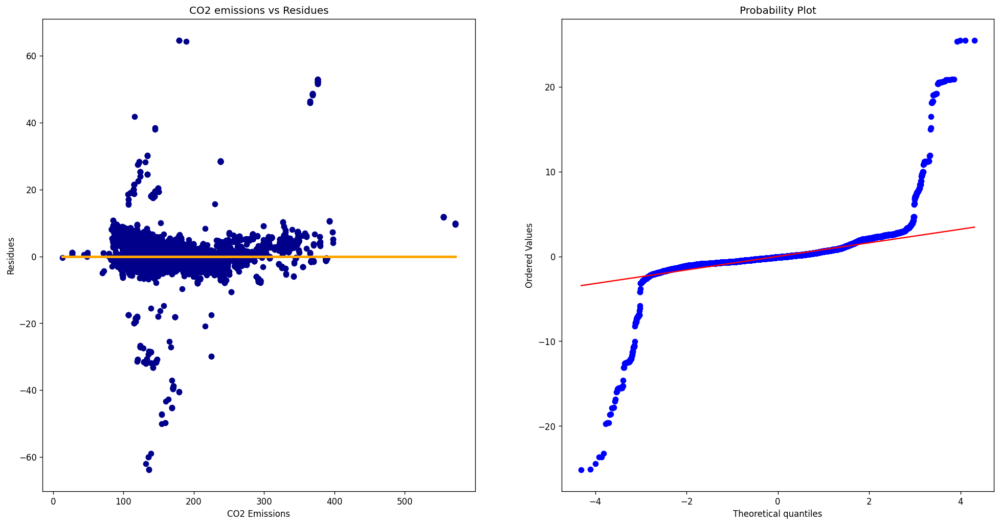

In [22]:
# Calculation of the adjustes values and residues of the model
residues = y_train_pred - y_train

# Centering and reduction of the residues
residues_norm = (residues - residues.mean()) / residues.std()

# Display of the two graph
plt.figure(figsize = (20, 10))

# Display of the scatterplot
plt.subplot(1, 2, 1)
plt.scatter(x = y_train, y = residues, color = 'darkblue')
plt.plot((y_train.min(),y_train.max()), (0, 0), lw=3, color = 'orange')
plt.xlabel('CO2 Emissions')
plt.ylabel('Residues')
plt.title("CO2 emissions vs Residues")

# Display of the QQ-plot
plt.subplot(1, 2, 2)
stats.probplot(residues_norm, plot = plt)

plt.show();

> Let's firt analyse the first plot: Normally it should be randomly scattered around y = 0 with no apparent structure. Here it seems that there is no clear structure in their distribution and the points are evenly distributed around y = 0.
>
> We can implement the Breusch-Pagan test to check if the homo-sedasticity is present.
> The hypothesis are the following:
> - Null Hypothesis (H0): homo-sedasticity is present (the residuals are distributed with equal variance)
> - Alternative Hypothesis (H1): Heteroscedasticity is present (the residuals are not distributed with equal variance)

In [23]:
# Conduct the Breusch-Pagan test
names = ['Lagrange multiplier statistic', 'p-value',
         'f-value', 'f p-value']
 
# Get the test result
exog = sm.add_constant(X_train_robust, prepend = True)
lm, lm_p_value, fvalue, f_p_value = sms.het_breuschpagan(residues, exog)
 
print(f"Breusch-Pagan test p-value: {lm_p_value}")

Breusch-Pagan test p-value: 0.0


> We can see that p-value < 0.05 therefore we can reject the Null Hypothesis and we conclude H1.So Heteroscedasticity is present

> Let's now analyse the Theoretical quantiles graph: The normality of the residues is validated if the point are aligned with the first bisector. Here we can see that this not the case.
>
> We can implement the Jarque-Bera Test to check the normality of the residues. The hypothesis are the following:
> - Null Hypothesis (H0): Data follow a normal distribution.
> - Alternative Hypothesis (H1): Data does not follow a normal distribution.

In [24]:
# Conduct the Jarque-Bera test
stats.jarque_bera(residues)

SignificanceResult(statistic=69437060.52782615, pvalue=0.0)

> We can see that p-value < 0.05 therefore we can reject the Null Hypothesis and we conclude H1.So Data doesn't follow a normal distribution

> Conclusion: Our model doesn't respect the two assumptions about homo-sedasticity and normality of the errors. Let's use Regularized Linear Regression and investigate if it can solve the problem.

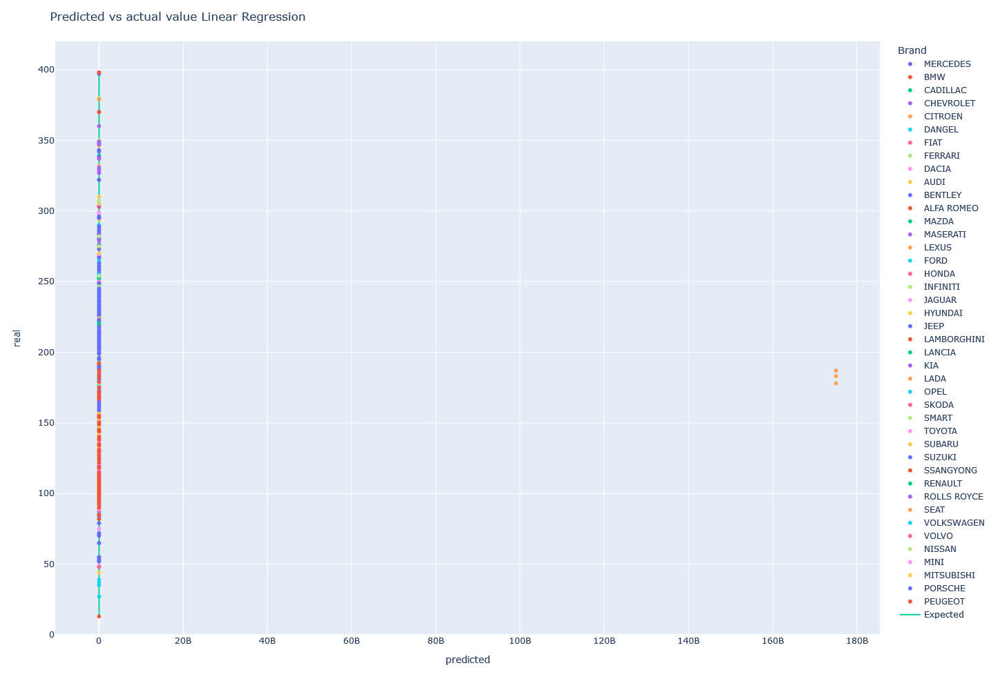

In [25]:
# Display of the Predicted vs Actual Value for Linear Regression
fig = px.scatter(
    x=y_test_pred, 
    y=y_test,
    hover_name=df['lib_mrq_utac'][df.year==2015],
    color=df['lib_mrq_utac'][df.year==2015],
    labels={
        'x':'predicted',
        'y':'real',
        'color':'Brand'
    }
)

fig.update_layout(
    title='Predicted vs actual value Linear Regression',
    height=1000,
)

fig.add_scatter(
    x = [y_test.min(), y_test.max()],
    y = [y_test.min(), y_test.max()],
    name = 'Expected',
    mode = 'lines'
)

# Y axis scale
fig['layout']['yaxis']['range']=[0,420]

fig.show()
fig.write_image('imgs/0-Linear Regression.svg', width=1600, height=1000)

# 7. Regularized Linear Regression

## 7.1. RidgeCV

In [26]:
# Instantiate of the RidgeCV model
k_folds = KFold(n_splits = 5)
alphas = [1e-5, 1e-4, 1e-3, 1e-2, 0.1, 0.3, 0.5, 0.7, 1, 5 , 10, 20, 30, 40, 75, 100, 200, 500, 700, 1000, 10000, 50000]
ridge_reg = RidgeCV(alphas = alphas, cv = k_folds)
ridge_reg.fit(X_train, y_train)

RidgeCV(alphas=[1e-05, 0.0001, 0.001, 0.01, 0.1, 0.3, 0.5, 0.7, 1, 5, 10, 20,
                30, 40, 75, 100, 200, 500, 700, 1000, 10000, 50000],
        cv=KFold(n_splits=5, random_state=None, shuffle=False))

In [27]:
# Display of the retained alpha
print(f'The selected alpha is: {ridge_reg.alpha_}')

The selected alpha is: 0.1


In [28]:
k_folds = KFold(n_splits = 5)
scores = cross_val_score(ridge_reg, X_test, y_test, cv = k_folds)

In [29]:
print("Cross Validation Scores: ", scores)
print("Average CV Score: ", scores.mean())
print("Number of CV Scores used in Average: ", len(scores))

Cross Validation Scores:  [0.99127776 0.99498642 0.98920341 0.9964397  0.99344258]
Average CV Score:  0.9930699734305932
Number of CV Scores used in Average:  5


In [30]:
# Display of the coefficient of the RidgeCV Regression
coef = pd.DataFrame(
    ridge_reg.coef_
)
coef['Var'] = X_train.columns
coef = coef[['Var', 0]]
print(coef.to_markdown())

|    | Var               |            0 |
|---:|:------------------|-------------:|
|  0 | puiss_max         | -0.98213     |
|  1 | conso_mixte       | 36.7492      |
|  2 | co_typ_1          | -0.630031    |
|  3 | hc                |  0.573866    |
|  4 | nox               |  1.15938     |
|  5 | hcnox             | -0.857552    |
|  6 | masse_ordma_max   |  1.18535     |
|  7 | cod_cbr_EE        | -0.00444194  |
|  8 | cod_cbr_EH        | -0.325604    |
|  9 | cod_cbr_ES        | -3.02936     |
| 10 | cod_cbr_ES/GP     | -1.17605     |
| 11 | cod_cbr_FE        | -3.62743     |
| 12 | cod_cbr_GH        |  0.368352    |
| 13 | cod_cbr_GL        |  0.0297185   |
| 14 | cod_cbr_GN        | -1.83263     |
| 15 | cod_cbr_GN/ES     | -0.490559    |
| 16 | cod_cbr_GO        |  3.55687     |
| 17 | hybride_non       |  0.0820587   |
| 18 | hybride_oui       | -0.0820587   |
| 19 | type_of_gearbox_A |  0.0547365   |
| 20 | type_of_gearbox_D |  0.0206881   |
| 21 | type_of_gearbox_M | -0.0509

In [31]:
# Prediction of the train and test set
ridge_pred_train = ridge_reg.predict(X_train)
ridge_pred_test = ridge_reg.predict(X_test)

In [32]:
# Display R2
R2_train = ridge_reg.score(X_train, y_train)
R2_test = ridge_reg.score(X_test, y_test)

print(f'Score train : {R2_train:.4f}')
print(f'Score test  : {R2_test:.4f}')

# Display MSE
MSE_train = mean_squared_error(y_train, ridge_pred_train)
MSE_test = mean_squared_error(y_test, ridge_pred_test)

print(f'MSE train :   {MSE_train:.2f}')
print(f'MSE test  :   {MSE_test:.2f}')

# Display RMSE
RMSE_train = mean_squared_error(y_train, ridge_pred_train, squared = False)
RMSE_test = mean_squared_error(y_test, ridge_pred_test, squared = False)

print(f'RMSE train :   {RMSE_train:.2f}')
print(f'RMSE test  :   {RMSE_test:.2f}')

# Display MAE
MAE_train = mean_absolute_error(y_train, ridge_pred_train)
MAE_test = mean_absolute_error(y_test, ridge_pred_test)

print(f'MAE train :   {MAE_train:.2f}')
print(f'MAE test  :   {MAE_test:.2f}')

# Summary Tables of the results
dic_lr= {'R2': [R2_train, R2_test], 'MAE': [MAE_train, MAE_test], 'MSE' : [MSE_train, MSE_test], 'RMSE' : [RMSE_train, RMSE_test]}
results_lr = pd.DataFrame(dic_lr, index = ['Train', 'Test'])

results_lr['R2'] = results_lr['R2'].round(decimals=4)
results_lr[['MAE', 'MSE', 'RMSE']] = results_lr[['MAE', 'MSE', 'RMSE']].round(decimals=2)

results_lr

Score train : 0.9953
Score test  : 0.9929
MSE train :   6.43
MSE test  :   13.44
RMSE train :   2.54
RMSE test  :   3.67
MAE train :   1.41
MAE test  :   2.68


,R2,MAE,MSE,RMSE
Train,0.9953,1.41,6.43,2.54
Test,0.9929,2.68,13.44,3.67


> Let's analyse of the residues

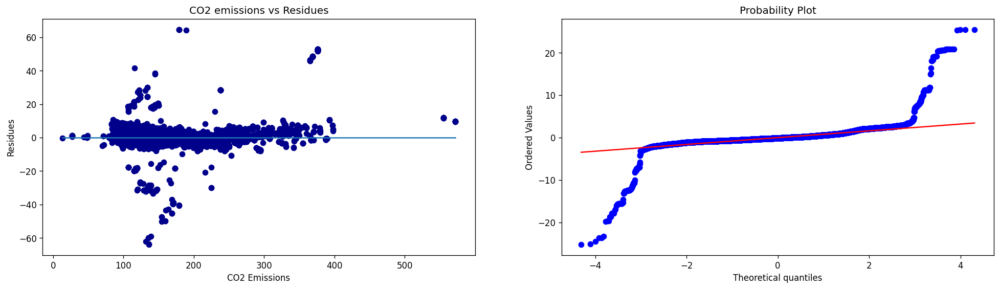

In [33]:
# Calculation of the adjustes values and residues of the model
residues_ridge = ridge_pred_train - y_train

# Centering and reduction of the residues
residues_ridge_norm = (residues_ridge - residues_ridge.mean()) / residues_ridge.std()

# Display of the two graph
plt.figure(figsize = (20, 5))

# Display of the scatterplot
plt.subplot(1, 2, 1)
plt.scatter(x = y_train, y = residues_ridge, color = 'darkblue')
plt.plot((y_train.min(),y_train.max()), (0, 0))
plt.xlabel('CO2 Emissions')
plt.ylabel('Residues')
plt.title("CO2 emissions vs Residues")

# Display of the QQ-plot
plt.subplot(1, 2, 2)
stats.probplot(residues_ridge_norm, plot = plt)

plt.show();

In [34]:
# Conduct the Breusch-Pagan test
names = ['Lagrange multiplier statistic', 'p-value',
         'f-value', 'f p-value']
 
# Get the test result
exog = sm.add_constant(X_train_robust, prepend = True)
lm, lm_p_value, fvalue, f_p_value = sms.het_breuschpagan(residues, exog)
 
print(f"Breusch-Pagan test p-value: {lm_p_value}")

# Conduct the Jarque-Bera test
stats.jarque_bera(residues)

Breusch-Pagan test p-value: 0.0


SignificanceResult(statistic=69437060.52782615, pvalue=0.0)

> In this case again we can see that the both tests are rejections the null hypothesis therefore the residues are Heteroscedastic and does not follow the normality

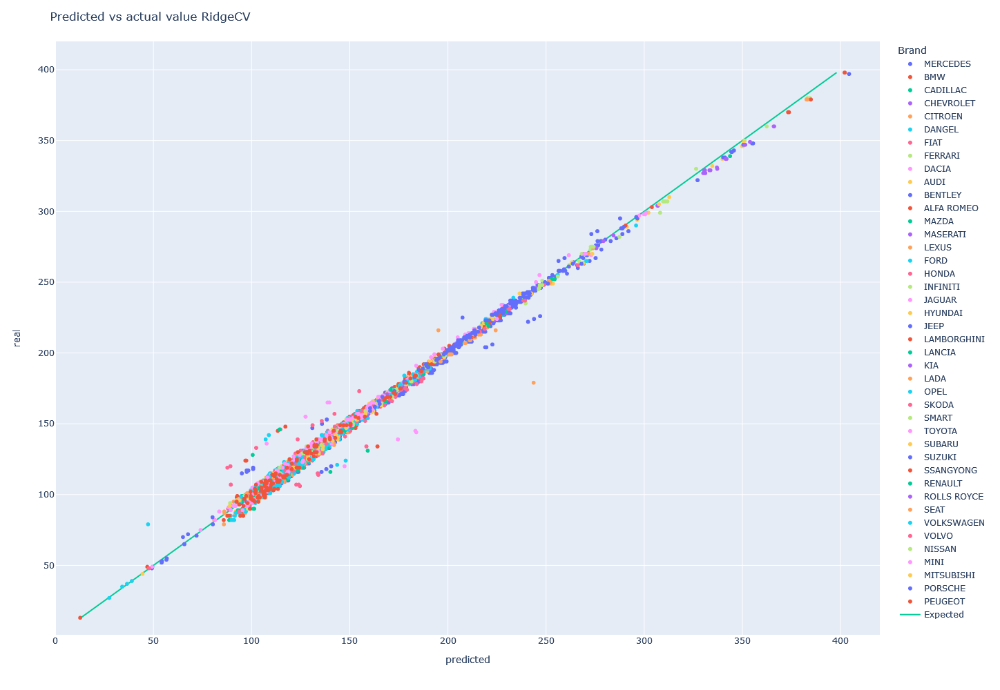

In [35]:
fig = px.scatter(
    x=ridge_pred_test, 
    y=y_test,
    hover_name=df['lib_mrq_utac'][df.year==2015],
    color=df['lib_mrq_utac'][df.year==2015],
    labels={
        'x':'predicted',
        'y':'real',
        'color':'Brand'
    }
)

fig.update_layout(
    title='Predicted vs actual value RidgeCV',
    height=1000,
)
fig.add_scatter(
    x = [y_test.min(), y_test.max()],
    y = [y_test.min(), y_test.max()],
    name = 'Expected',
    mode = 'lines'
)

# Y axis scale
fig['layout']['xaxis']['range']=[0,420]
fig['layout']['yaxis']['range']=[1,420]

fig.show()
fig.write_image('imgs/0-RidgeCV.svg', width=1600, height=1000)

## 7.2. Lasso

In [36]:
lasso_r = Lasso(alpha=1.0)
lasso_r.fit(X_train, y_train)

Lasso()

In [37]:
pred_train = lasso_r.predict(X_train)
pred_test = lasso_r.predict(X_test)

In [38]:
# Display MSE
print(f'MSE train : {mean_squared_error(y_train, pred_train):.4f}')
print(f'MSE test  : {mean_squared_error(y_test, pred_test):.4f}')

MSE train : 13.8022
MSE test  : 33.7198


In [39]:
# Display R2
print(f'Score train : {lasso_r.score(X_train, y_train):.4f}')
print(f'Score test  : {lasso_r.score(X_test, y_test):.4f}')

Score train : 0.9899
Score test  : 0.9821


#### Lasso Path

In [40]:
alpha_list = (0.001, 0.01, 0.02, 0.025, 0.05, 0.1, 0.3, 0.5, 0.8, 1.0)
alpha_path, coefs_lasso, _ = lasso_path(
    X_train, 
    y_train,
    alphas=alpha_list
)

In [41]:
# fig = plt.figure(figsize=(16, 6))
# ax = fig.add_subplot(111)

# for i in range(coefs_lasso.shape[1]):
#     ax.plot(
#         range(len(coefs_lasso[i])),
#         coefs_lasso[i],
#         'o',
#         label=f'{X_train.columns[i]}'
#     )

# ax.set_xticks(
#     range(len(alpha_path)), 
#     alpha_path
# )

# ax.set_title('Lasso coefs vs alpha')
# ax.set_ylabel('coefs lasso')
# ax.set_xlabel(r'$\alpha$')

# ax.legend(
#     bbox_to_anchor=(1.01, 1.013),
#     fancybox=False, 
#     framealpha=1, 
#     borderpad=1,
#     edgecolor='k',
#     fontsize='small'
# )

# plt.show()

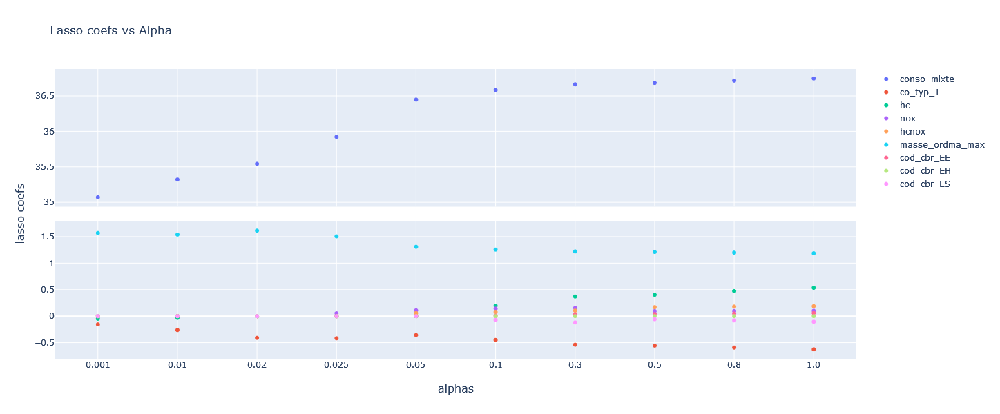

In [42]:
fig = make_subplots(
    rows=2, cols=1, 
    shared_xaxes=True, x_title='alphas',
    y_title='lasso coefs',
    vertical_spacing = 0.05
)

fig.add_trace(
        go.Scatter(
            x=[f'{a}' for a in alpha_list], 
            y=coefs_lasso[1],
            mode='markers',
            name=f'{X_train.columns[1]}'
        ),
        row=1,col=1
    )

for i in range(1, coefs_lasso.shape[1]):
    if i != 1:
        fig.add_trace(
            go.Scatter(
                x=[f'{a}' for a in alpha_list], 
                y=coefs_lasso[i],
                mode='markers',
                name=f'{X_train.columns[i]}'
            ),
            row=2,col=1
        )

fig.update_layout(
    title='Lasso coefs vs Alpha',
    height=600
)

fig.show()
fig.write_image('imgs/0-LassoPath.svg', width=1000, height=500)

## 7.3. LassoCV

In [43]:
alpha_list = (0.001, 0.01, 0.02, 0.025, 0.05, 0.1, 0.3, 0.5, 0.8, 1.0)
model_lasso = LassoCV(cv=10, alphas=alpha_list)
model_lasso.fit(X_train, y_train)

LassoCV(alphas=(0.001, 0.01, 0.02, 0.025, 0.05, 0.1, 0.3, 0.5, 0.8, 1.0), cv=10)

In [44]:
dir(model_lasso)

['__abstractmethods__',
 '__annotations__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__sklearn_clone__',
 '__slots__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_abc_impl',
 '_build_request_for_signature',
 '_check_feature_names',
 '_check_n_features',
 '_decision_function',
 '_doc_link_module',
 '_doc_link_template',
 '_doc_link_url_param_generator',
 '_estimator_type',
 '_get_default_requests',
 '_get_doc_link',
 '_get_estimator',
 '_get_metadata_request',
 '_get_param_names',
 '_get_tags',
 '_is_multitask',
 '_more_tags',
 '_parameter_constraints',
 '_repr_html_',
 '_repr_html_inner',
 '_repr_mimebundle_',
 '_set_intercept',
 '_validate_data',
 '_validate_params',

In [45]:
alphas = model_lasso.alphas_
mses =  model_lasso.mse_path_

In [46]:
mses_t = np.transpose(mses)

In [47]:
# fig = plt.figure(figsize=(14, 6))
# ax = fig.add_subplot(111)

# for i in range(mses_t.shape[0]):
#     ax.plot(
#         alphas,
#         mses_t[i],
#         'o',
#         label=f'sample {i+1:02}'
#     )

# ax.set_title('MSE vs alpha')
# ax.set_ylabel('MSE')
# ax.set_xlabel(r'$\alpha$')
# ax.legend(
#     bbox_to_anchor=(1.01, 1.013),
#     fancybox=False, 
#     framealpha=1, 
#     borderpad=1,
#     edgecolor='k',
#     fontsize='small'
# )

# plt.show()

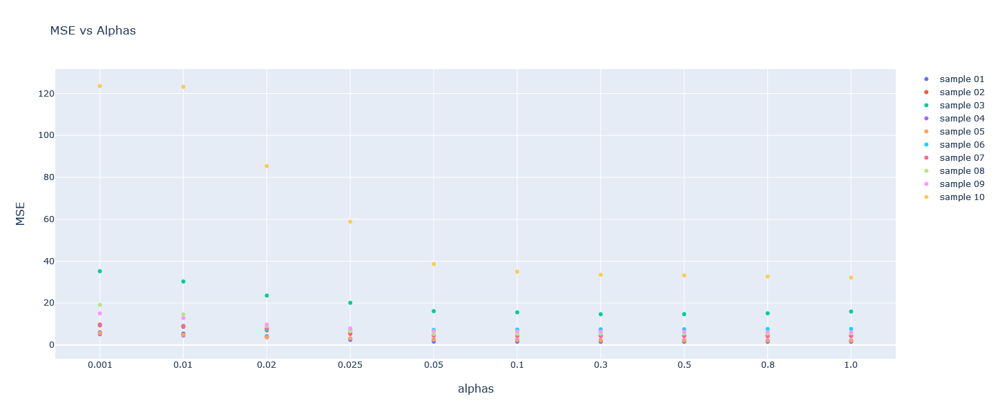

In [48]:
fig = make_subplots(
    x_title='alphas',
    y_title='MSE'
)

for i in range(mses_t.shape[0]):
    fig.add_trace(
        go.Scatter(
            x=[f'{a}' for a in alphas[::-1]], 
            y=mses_t[::-1][i],
            mode='markers',
            name=f'sample {i+1:02}'
        )
    )

fig.update_layout(
    title='MSE vs Alphas',
    height=600
)

fig.show()
fig.write_image('imgs/0-MSE vs Alphas.svg', width=1000, height=500)

In [49]:
lasso_pred_train = model_lasso.predict(X_train)
lasso_pred_test = model_lasso.predict(X_test)

# Display MSE
print(f'Score train : {model_lasso.score(X_train, y_train):.2f}')
print(f'Score test  : {model_lasso.score(X_test, y_test):.2f}')

# Display R2
print(f'\nMSE train: {mean_squared_error(y_train, lasso_pred_train):.4f}')
print(f'MSE test : {mean_squared_error(y_test, lasso_pred_test):.4f}')

Score train : 1.00
Score test  : 0.99

MSE train: 6.4377
MSE test : 13.5056


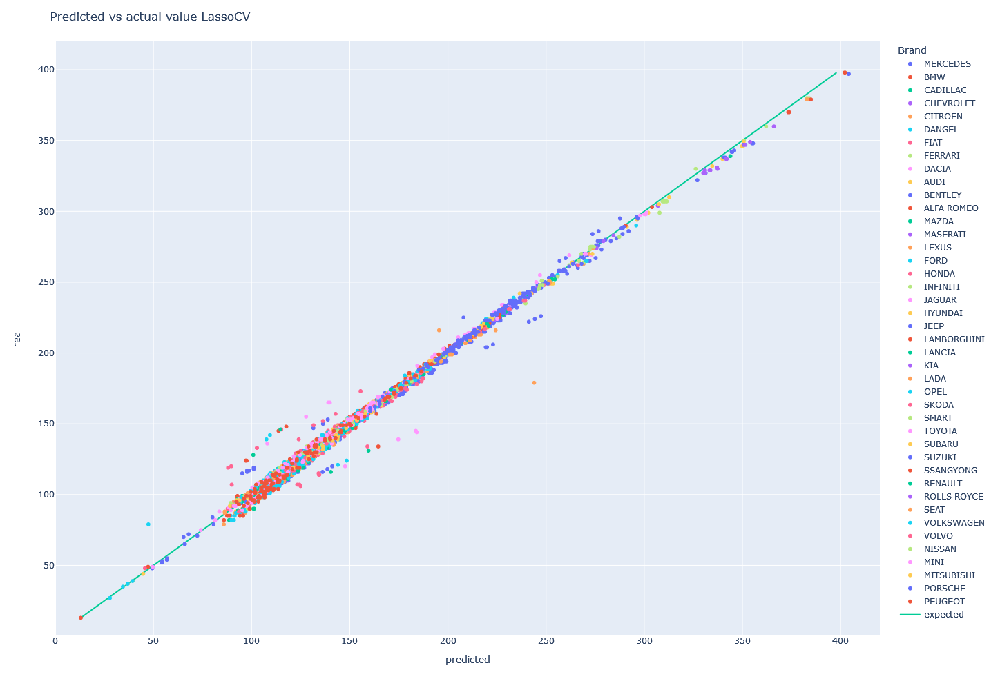

In [50]:
fig = px.scatter(
    x=lasso_pred_test, 
    y=y_test,
    hover_name=df['lib_mrq_utac'][df.year==2015],
    color=df['lib_mrq_utac'][df.year==2015],
    labels={
        'x':'predicted',
        'y':'real',
        'color':'Brand'
    }
)

fig.update_layout(
    title='Predicted vs actual value LassoCV',
    height=1000,
)
fig.add_scatter(
    x = [y_test.min(), y_test.max()],
    y = [y_test.min(), y_test.max()],
    name = 'expected',
    mode = 'lines'
)

# Y axis scale
fig['layout']['xaxis']['range']=[0,420]
fig['layout']['yaxis']['range']=[1,420]

fig.show()
fig.write_image('imgs/0-LassoCV.svg', width=1600, height=1000)

In [51]:
# fig = plt.figure(figsize=(20,8))
# ax = fig.add_subplot(111)
    
# ax.scatter(
#     lasso_pred_test, 
#     y_test, 
#     label='model'
# )
# ax.plot(
#     [y_test.min(), y_test.max()],
#     [y_test.min(), y_test.max()],
#     '--r',
#     label='expected'
# )

# ax.set_ylabel('predicted')
# ax.set_xlabel('value')
# ax.set_title('Predicted vs actual value')
# plt.legend()

# plt.show()

In [52]:
# Display R2
R2_train = model_lasso.score(X_train, y_train)
R2_test = model_lasso.score(X_test, y_test)

print(f'Score train : {R2_train:.4f}')
print(f'Score test  : {R2_test:.4f}')

# Display MSE
MSE_train = mean_squared_error(y_train, lasso_pred_train)
MSE_test = mean_squared_error(y_test, lasso_pred_test)

print(f'MSE train :   {MSE_train:.2f}')
print(f'MSE test  :   {MSE_test:.2f}')

# Display RMSE
RMSE_train = mean_squared_error(y_train, lasso_pred_train, squared = False)
RMSE_test = mean_squared_error(y_test, lasso_pred_test, squared = False)

print(f'RMSE train :   {RMSE_train:.2f}')
print(f'RMSE test  :   {RMSE_test:.2f}')

# Display MAE
MAE_train = mean_absolute_error(y_train, lasso_pred_train)
MAE_test = mean_absolute_error(y_test, lasso_pred_test)

print(f'MAE train :   {MAE_train:.2f}')
print(f'MAE test  :   {MAE_test:.2f}')

# Summary Tables of the results
dic_lr= {'R2': [R2_train, R2_test], 'MAE': [MAE_train, MAE_test], 'MSE' : [MSE_train, MSE_test], 'RMSE' : [RMSE_train, RMSE_test]}
results_lr = pd.DataFrame(dic_lr, index = ['Train', 'Test'])

results_lr['R2'] = results_lr['R2'].round(decimals=4)
results_lr[['MAE', 'MSE', 'RMSE']] = results_lr[['MAE', 'MSE', 'RMSE']].round(decimals=2)

results_lr

Score train : 0.9953
Score test  : 0.9928
MSE train :   6.44
MSE test  :   13.51
RMSE train :   2.54
RMSE test  :   3.67
MAE train :   1.42
MAE test  :   2.70


,R2,MAE,MSE,RMSE
Train,0.9953,1.42,6.44,2.54
Test,0.9928,2.70,13.51,3.67


## 7.4. ElasticNetCV

In [53]:
l1_ratio = (0.1, 0.25, 0.5, 0.7, 0.75, 0.8, 0.85, 0.9, 0.99)
alphas= (0.001, 0.01, 0.02, 0.025, 0.05, 0.1, 0.25, 0.5, 0.8, 1.0)

model_en = ElasticNetCV(
    l1_ratio = l1_ratio,
    alphas= alphas,
    cv=8
)

In [54]:
model_en.fit(X_train, y_train)

ElasticNetCV(alphas=(0.001, 0.01, 0.02, 0.025, 0.05, 0.1, 0.25, 0.5, 0.8, 1.0),
             cv=8, l1_ratio=(0.1, 0.25, 0.5, 0.7, 0.75, 0.8, 0.85, 0.9, 0.99))

In [55]:
model_en.coef_

array([-9.58289725e-01,  3.67097598e+01, -5.95656470e-01,  4.72197135e-01,
        0.00000000e+00,  2.77784800e-01,  1.20181139e+00, -0.00000000e+00,
       -3.26777080e-01, -2.36215963e+00, -1.10050628e+00, -3.55245425e+00,
        3.51744919e-01,  1.77757623e-02, -1.76117034e+00, -4.39254082e-01,
        4.21362578e+00,  0.00000000e+00, -0.00000000e+00,  1.43983111e-01,
        1.55783305e-02, -0.00000000e+00,  0.00000000e+00, -4.45810549e-03,
       -0.00000000e+00,  2.11960404e-02,  5.62206856e-01, -1.35447733e-01,
        8.25558169e-03, -1.48024741e-03, -0.00000000e+00, -3.86408695e-02,
        0.00000000e+00,  5.72972553e-01, -2.78781352e-01,  0.00000000e+00,
       -2.14639795e-02, -1.58816994e-02])

In [56]:
coeffs = list(model_en.coef_)
coeffs.insert(0, model_en.intercept_)

feats = list(data.columns)
feats.insert(0, 'intercept')

results = pd.DataFrame({'coeffs': coeffs}, index=feats)
results.coeffs = results.coeffs.round(5)
print(results[~(results.coeffs == 0)].round(2).to_markdown())

|                   |   coeffs |
|:------------------|---------:|
| intercept         |   200.42 |
| puiss_max         |    -0.96 |
| conso_mixte       |    36.71 |
| co_typ_1          |    -0.6  |
| hc                |     0.47 |
| hcnox             |     0.28 |
| masse_ordma_max   |     1.2  |
| cod_cbr_EH        |    -0.33 |
| cod_cbr_ES        |    -2.36 |
| cod_cbr_ES/GP     |    -1.1  |
| cod_cbr_FE        |    -3.55 |
| cod_cbr_GH        |     0.35 |
| cod_cbr_GL        |     0.02 |
| cod_cbr_GN        |    -1.76 |
| cod_cbr_GN/ES     |    -0.44 |
| cod_cbr_GO        |     4.21 |
| type_of_gearbox_A |     0.14 |
| type_of_gearbox_D |     0.02 |
| type_of_gearbox_V |    -0    |
| nbr_reports_4     |     0.02 |
| nbr_reports_5     |     0.56 |
| nbr_reports_6     |    -0.14 |
| nbr_reports_7     |     0.01 |
| nbr_reports_8     |    -0    |
| nbr_reports_0     |    -0.04 |
| nbr_reports_5     |     0.57 |
| nbr_reports_6     |    -0.28 |
| nbr_reports_8     |    -0.02 |
| nbr_repo

In [57]:
elasticn_pred_train = model_en.predict(X_train)
elasticn_pred_test = model_en.predict(X_test)

# Display MSE
print(f'MSE train : {mean_squared_error(y_train, elasticn_pred_train):.2f}')
print(f'MSE test  : {mean_squared_error(y_test, elasticn_pred_test):.2f}')

# Display R2
print(f'Score train : {model_en.score(X_train, y_train):.4f}')
print(f'Score test  : {model_en.score(X_test, y_test):.4f}')

MSE train : 6.44
MSE test  : 13.52
Score train : 0.9953
Score test  : 0.9928


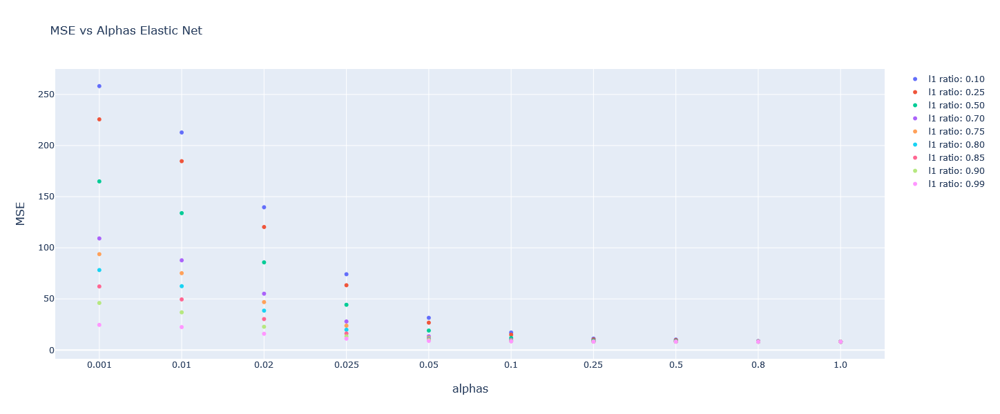

In [58]:
mse_path = model_en.mse_path_
l1_ratios = model_en.l1_ratio
alphas = model_en.alphas_

fig = make_subplots(
    x_title='alphas',
    y_title='MSE'
)

for i in range(model_en.mse_path_.shape[0]):
    fig.add_trace(
        go.Scatter(
            x=[f'{a}' for a in alphas[::-1]], 
            y=[np.average(l) for l in mse_path[i]],
            mode='markers',
            name=f'l1 ratio: {l1_ratios[i]:.2f}'
        )
    )

fig.update_layout(
    title='MSE vs Alphas Elastic Net',
    height=600
)

fig.show()
fig.write_image('imgs/0-MSE vs Alphas - Elastic NET.svg', width=1000, height=500)

In [59]:
# Display R2
R2_train = model_en.score(X_train, y_train)
R2_test = model_en.score(X_test, y_test)

print(f'Score train : {R2_train:.4f}')
print(f'Score test  : {R2_test:.4f}')

# Display MSE
MSE_train = mean_squared_error(y_train, elasticn_pred_train)
MSE_test = mean_squared_error(y_test, elasticn_pred_test)

print(f'MSE train :   {MSE_train:.2f}')
print(f'MSE test  :   {MSE_test:.2f}')

# Display RMSE
RMSE_train = mean_squared_error(y_train, elasticn_pred_train, squared = False)
RMSE_test = mean_squared_error(y_test, elasticn_pred_test, squared = False)

print(f'RMSE train :   {RMSE_train:.2f}')
print(f'RMSE test  :   {RMSE_test:.2f}')

# Display MAE
MAE_train = mean_absolute_error(y_train, elasticn_pred_train)
MAE_test = mean_absolute_error(y_test, elasticn_pred_test)

print(f'MAE train :   {MAE_train:.2f}')
print(f'MAE test  :   {MAE_test:.2f}')

# Summary Tables of the results
dic_lr= {'R2': [R2_train, R2_test], 'MAE': [MAE_train, MAE_test], 'MSE' : [MSE_train, MSE_test], 'RMSE' : [RMSE_train, RMSE_test]}
results_lr = pd.DataFrame(dic_lr, index = ['Train', 'Test'])

results_lr['R2'] = results_lr['R2'].round(decimals=4)
results_lr[['MAE', 'MSE', 'RMSE']] = results_lr[['MAE', 'MSE', 'RMSE']].round(decimals=2)

results_lr

Score train : 0.9953
Score test  : 0.9928
MSE train :   6.44
MSE test  :   13.52
RMSE train :   2.54
RMSE test  :   3.68
MAE train :   1.42
MAE test  :   2.70


,R2,MAE,MSE,RMSE
Train,0.9953,1.42,6.44,2.54
Test,0.9928,2.70,13.52,3.68


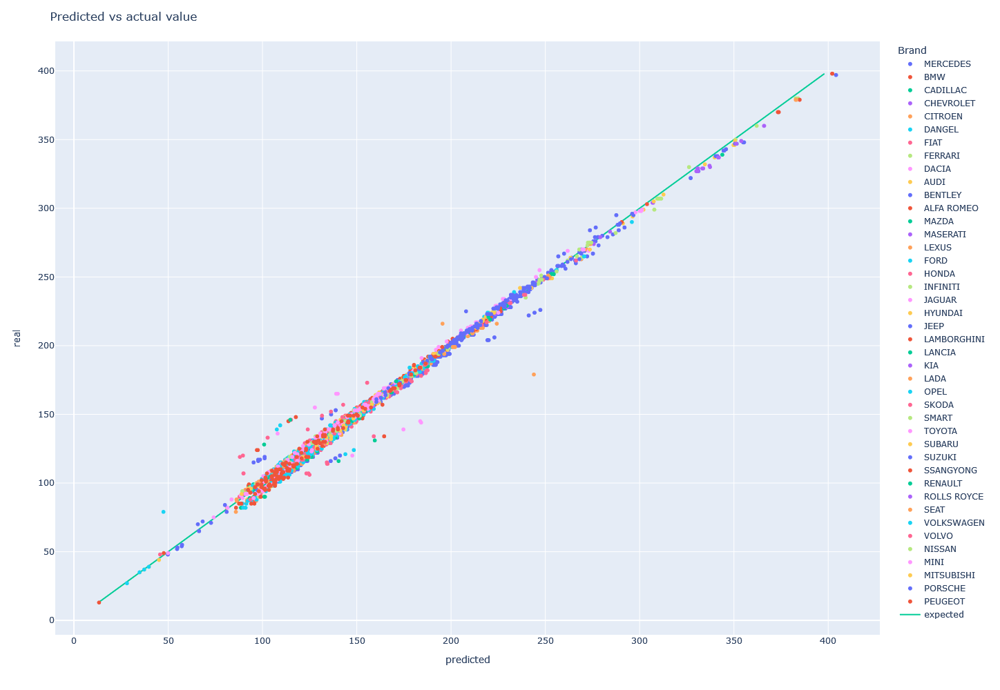

In [60]:
fig = px.scatter(
    x=elasticn_pred_test, 
    y=y_test,
    hover_name=df['lib_mrq_utac'][df.year==2015],
    color=df['lib_mrq_utac'][df.year==2015],
    labels={
        'x':'predicted',
        'y':'real',
        'color':'Brand'
    }
)

fig.update_layout(
    title='Predicted vs actual value',
    height=1000,
)
fig.add_scatter(
    x = [y_test.min(), y_test.max()],
    y = [y_test.min(), y_test.max()],
    name = 'expected',
    mode = 'lines'
)

fig.show()
fig.write_image('imgs/0-ElasticNetCV.svg', width=1600, height=1000)

In [61]:
# fig = plt.figure(figsize=(20,8))
# ax = fig.add_subplot(111)
    
# ax.scatter(
#     elasticn_pred_test, 
#     y_test, 
#     label='model'
# )
# ax.plot(
#     [y_test.min(), y_test.max()],
#     [y_test.min(), y_test.max()],
#     '--r',
#     label='expected'
# )

# ax.set_ylabel('predicted')
# ax.set_xlabel('value')
# ax.set_title('Predicted vs actual value')
# plt.legend()

# plt.show()

## 7.5. Summary

In [62]:
# RidgeCV
# ---
print('RidgeCV\n---')
ridge_pred_train = ridge_reg.predict(X_train)
ridge_pred_test = ridge_reg.predict(X_test)

# Display MSE
ridge_mse_train = mean_squared_error(y_train, ridge_pred_train)
ridge_mse_test = mean_squared_error(y_test, ridge_pred_test)
print(f'MSE train   : {ridge_mse_train:.4f}')
print(f'MSE test    : {ridge_mse_test:.4f}')

# Display R2
ridge_score_train = ridge_reg.score(X_train, y_train)
ridge_score_test = ridge_reg.score(X_test, y_test)
print(f'Score train : {ridge_score_train:.4f}')
print(f'Score test  : {ridge_score_test:.4f}')

# LassoCV
# ---
print('\nLassoCV\n---')
lasso_pred_train = model_lasso.predict(X_train)
lasso_pred_test = model_lasso.predict(X_test)

# Display MSE
lasso_mse_train = mean_squared_error(y_train, lasso_pred_train)
lasso_mse_test = mean_squared_error(y_test, lasso_pred_test)
print(f'MSE train   : {lasso_mse_train:.4f}')
print(f'MSE test    : {lasso_mse_test:.4f}')

# Display R2
lasso_score_train = model_lasso.score(X_train, y_train)
lasso_score_test = model_lasso.score(X_test, y_test)
print(f'Score train : {lasso_score_train:.4f}')
print(f'Score test  : {lasso_score_test:.4f}')

# ElasticNetCV
# ---
print('\nElasticNetCV\n---')
elasticn_pred_train = model_en.predict(X_train)
elasticn_pred_test = model_en.predict(X_test)

# Display MSE
elasticn_mse_train = mean_squared_error(y_train, elasticn_pred_train)
elasticn_mse_test = mean_squared_error(y_test, elasticn_pred_test)
print(f'MSE train   : {elasticn_mse_train:.4f}')
print(f'MSE test    : {elasticn_mse_test:.4f}')

# Display R2
elasticn_score_train = model_en.score(X_train, y_train)
elasticn_score_test = model_en.score(X_test, y_test)
print(f'Score train : {elasticn_score_train:.4f}')
print(f'Score test  : {elasticn_score_test:.4f}')

RidgeCV
---
MSE train   : 6.4336
MSE test    : 13.4444
Score train : 0.9953
Score test  : 0.9929

LassoCV
---
MSE train   : 6.4377
MSE test    : 13.5056
Score train : 0.9953
Score test  : 0.9928

ElasticNetCV
---
MSE train   : 6.4379
MSE test    : 13.5151
Score train : 0.9953
Score test  : 0.9928


In [63]:
models = ['RidgeCV', 'LassoCV', 'ElasticNetCV']

MSE_train = [ridge_mse_train, lasso_mse_train, elasticn_mse_train]
MSE_test = [ridge_mse_test, lasso_mse_test, elasticn_mse_test]

score_train = [ridge_score_train, lasso_score_train, elasticn_score_train]
score_test = [ridge_score_test, lasso_score_test, elasticn_score_test]

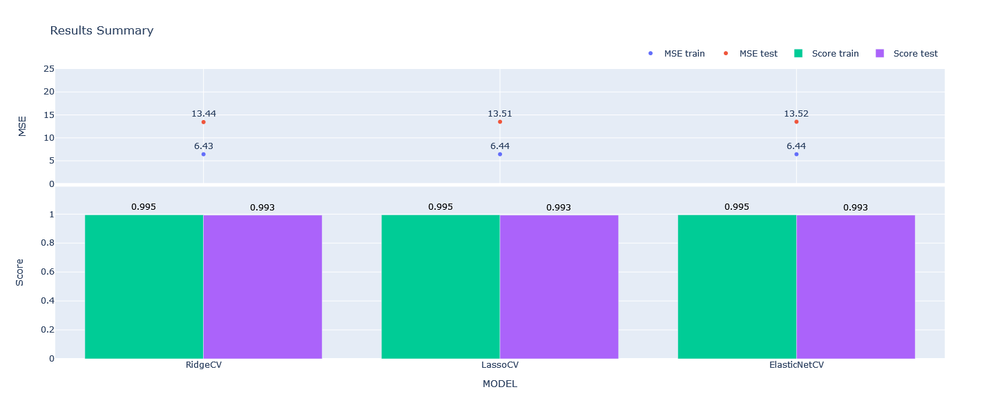

In [64]:
fig = make_subplots(
    rows=2, 
    cols=1, 
    shared_xaxes=True, 
    vertical_spacing = 0.01, 
    row_heights=[0.40, 0.60]
)

#  FIRST ROW
# ------------------------
fig.add_trace(
     go.Scatter(
        x=models, 
        y=MSE_train, 
        name="MSE train", 
        mode="markers+text",
        text=[f'{x:.2f}' for x in MSE_train],
        textposition="top center"
    ),
    row=1, col=1
)

fig.add_trace(
     go.Scatter(
        x=models, 
        y=MSE_test, 
        name="MSE test", 
        mode="markers+text",
        text=[f'{x:.2f}' for x in MSE_test],
        textposition="top center"
    ),
    row=1, col=1
)

#  SECOND ROW
# ------------------------
fig.add_trace(
    go.Bar(
        x=models, 
        y=score_train,
        text=[f'{x:.3f}' for x in score_train],
        textfont_color="black",
        textposition="outside",
        name="Score train"),
    row=2, col=1
)


fig.add_trace(
    go.Bar(
        x=models, 
        y=score_test,
        text=[f'{x:.3f}' for x in score_test],
        textfont_color="black",
        textposition="outside",
        name="Score test"),
    row=2, col=1
)

# Add figure title
fig.update_layout(
    title_text="Results Summary",
    template="plotly",
    legend=dict(
        orientation="h", 
        yanchor="bottom", 
        y=1.02,xanchor="right", 
        x=1),
    height=600
)

# Set x-axis title
# ------------------------
fig['layout']['yaxis']['title']='MSE'
fig['layout']['yaxis2']['title']='Score'
fig['layout']['xaxis2']['title']='MODEL'
# Y axis scale
fig['layout']['yaxis']['range']=[0,25]
fig['layout']['yaxis2']['range']=[0,1.19]

fig.show()
fig.write_image('imgs/0-Summary.svg', width=1000, height=600)

# 8. Neural Networks

In [65]:
# import tensorflow as tf
# from tensorflow.keras.models import Sequential, Model
# from tensorflow.keras.layers import Dense, Activation, Input
# from tensorflow.keras.layers import Dropout
# from tensorflow.keras.layers import Flatten
# from tensorflow.keras.layers import Conv2D
# from tensorflow.keras.layers import MaxPooling2D
# from keras.utils import to_categorical

# 9. Data Viz

In [66]:
X = pd.concat([X_train, X_test])
y = pd.concat([y_train, y_test])
y_pred = model_en.predict(X)

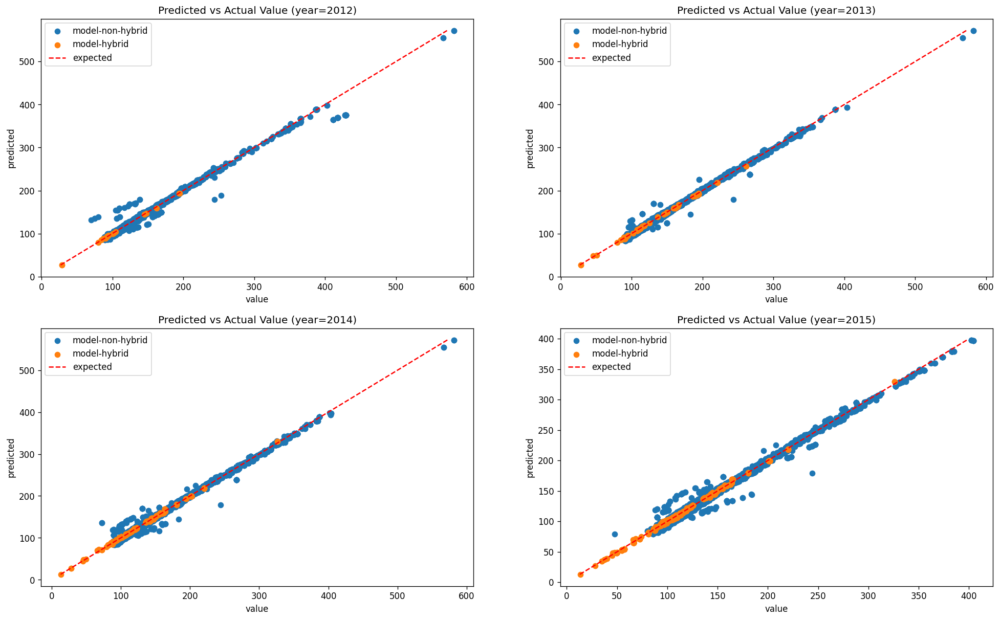

In [67]:
fig = plt.figure(figsize=(20,12))

for year in [2012, 2013, 2014, 2015]:

    criteria = (df.year==year) & ~(df.hybride=='oui')
    criteria2 = (df.year==year) & (df.hybride=='oui')
    
    ax = fig.add_subplot(2,2,year-2011)    
    ax.scatter(
        y_pred[criteria], 
        y[criteria],
        label='model-non-hybrid'
    )
    ax.scatter(
        y_pred[criteria2], 
        y[criteria2], 
        label='model-hybrid'
    )
    ax.plot(
        [min(y[criteria].min(), y[criteria2].min()), max(y[criteria].max(), y[criteria2].max())],
        [min(y[criteria].min(), y[criteria2].min()), max(y[criteria].max(), y[criteria2].max())],
        '--r',
        label='expected'
    )
    
    ax.set_ylabel('predicted')
    ax.set_xlabel('value')
    ax.set_title(f'Predicted vs Actual Value ({year=})')
    plt.legend()
plt.savefig('imgs\z-Predicted vs Actual Value.png', bbox_inches='tight')
plt.show()

In [68]:
df2 = df[['co2', 'year', 'hybride', 'type_of_gearbox', 'nbr_reports']]
df2['y_pred'] = y_pred
df2

,co2,year,hybride,type_of_gearbox,nbr_reports,y_pred
0,149.0,2012,non,M,6,149.491967
1,133.0,2012,non,M,6,133.579285
2,130.0,2012,non,M,6,131.127680
3,127.0,2012,non,M,6,128.676075
4,138.0,2012,non,A,7,141.223359
...,...,...,...,...,...,...
103243,154.0,2015,oui,A,7,155.215871
103244,159.0,2015,oui,A,7,157.009338
103245,161.0,2015,oui,A,7,162.570686
103246,153.0,2015,oui,A,7,152.106128


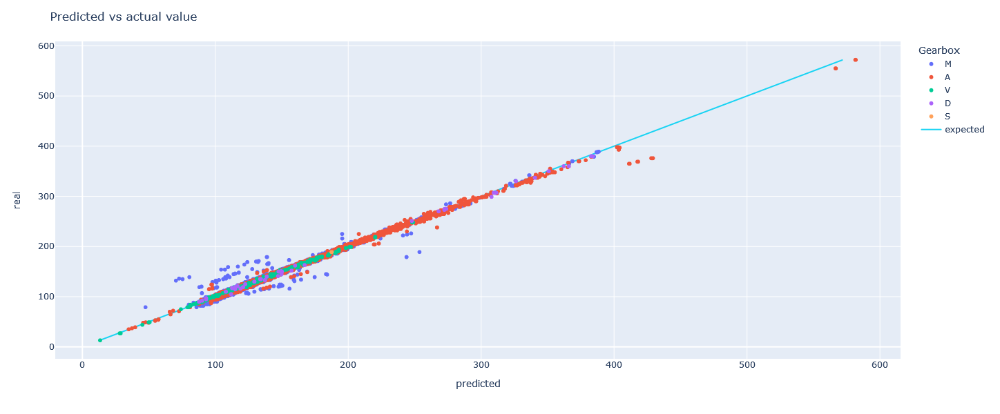

In [69]:
fig = px.scatter(
    data_frame=df2,
    x='y_pred',
    y='co2',
    hover_name=df['lib_mrq_utac'],
    color='type_of_gearbox',
    labels={
        'y_pred':'predicted',
        'co2':'real',
        'type_of_gearbox':'Gearbox'
    }
)

fig.update_layout(
    title='Predicted vs actual value',
    height=600,
)
fig.add_scatter(
    x = [df2.co2.min(), df2.co2.max()],
    y = [df2.co2.min(), df2.co2.max()],
    name = 'expected',
    mode = 'lines'
)

fig.show()

In [70]:
# fig = plt.figure(figsize=(16,6))
# ax = fig.add_subplot(111)

# sns.scatterplot(
#     data=df2,
#     x='y_pred',
#     y='co2',
#     hue='type_of_gearbox',
#     ax=ax
# )

# ax.plot(
#     [df2.y_pred.min(), df2.y_pred.max()],
#     [df2.y_pred.min(), df2.y_pred.max()],
#     '--r',
#     label='expected'
# )
# ax.set_ylabel('predicted')
# ax.set_xlabel('value')

# plt.show()

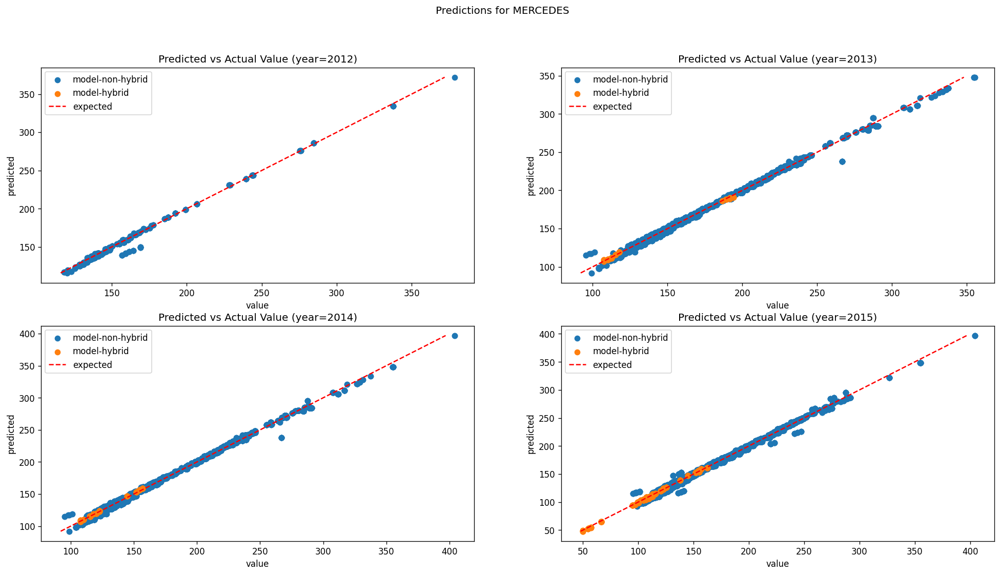

In [71]:
def plot_brand_per_year(brand, show_fig=True):
    fig = plt.figure(figsize=(20,10))
    # brand = 'MERCEDES'
    fig.suptitle(f'Predictions for {brand}')
    for year in [2012, 2013, 2014, 2015]:
        criteria = (df.year==year) & ~(df.hybride=='oui') & (df.lib_mrq_utac==brand)
        criteria2 = (df.year==year) & (df.hybride=='oui') & (df.lib_mrq_utac==brand)
        
        ax = fig.add_subplot(2,2,year-2011)    
        ax.scatter(
            y_pred[criteria], 
            y[criteria],
            label='model-non-hybrid'
        )
        ax.scatter(
            y_pred[criteria2], 
            y[criteria2], 
            label='model-hybrid'
        )
        ax.plot(
            [min(y[criteria].min(), y[criteria2].min()), max(y[criteria].max(), y[criteria2].max())],
            [min(y[criteria].min(), y[criteria2].min()), max(y[criteria].max(), y[criteria2].max())],
            '--r',
            label='expected'
        )
        
        ax.set_ylabel('predicted')
        ax.set_xlabel('value')
        ax.set_title(f'Predicted vs Actual Value ({year=})')
        plt.legend()
    
    # MSE = mean_squared_error(y[criteria], y_pred[criteria])
    # R2 = model_en.score(X[criteria], df.co2[criteria])
    # fig.suptitle(f'Predictions for {brand} ({MSE=:.2f})')
    # f'MSE test    : {mean_squared_error(y_test, elasticn_pred_test):.4f}'
    plt.savefig(f'imgs\z-Predictions for {brand}.png', bbox_inches='tight')
    if show_fig:
        plt.show()
    
plot_brand_per_year('MERCEDES')

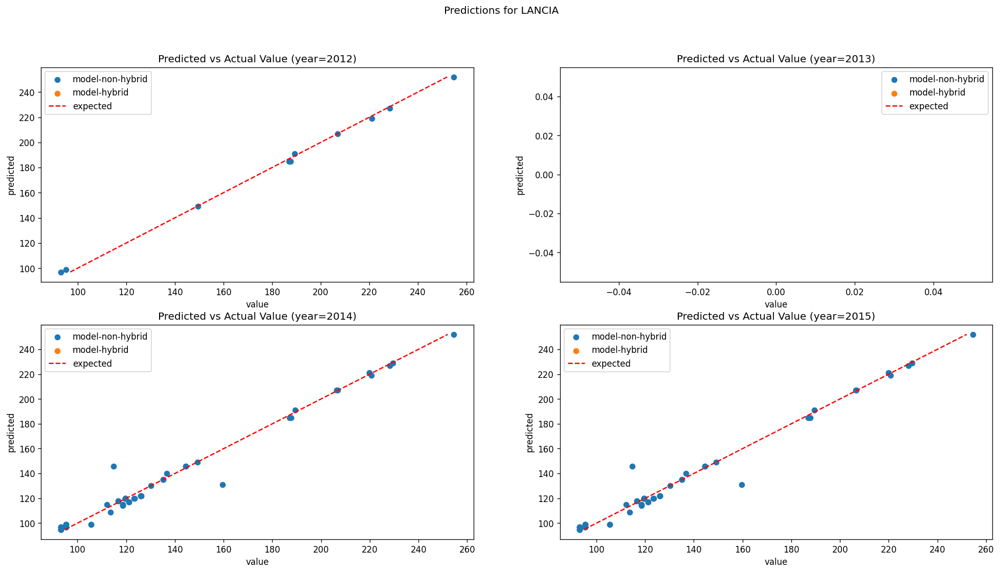

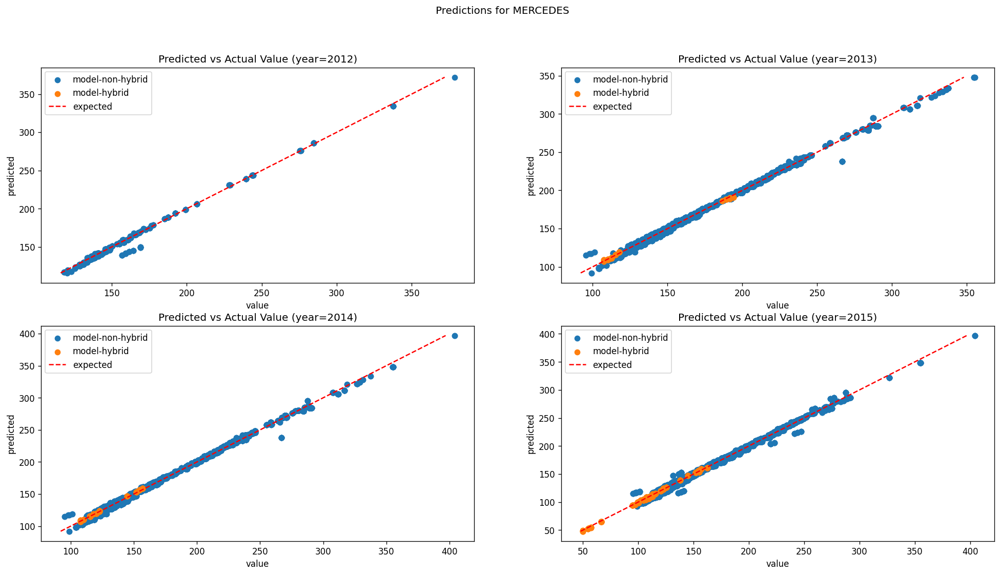

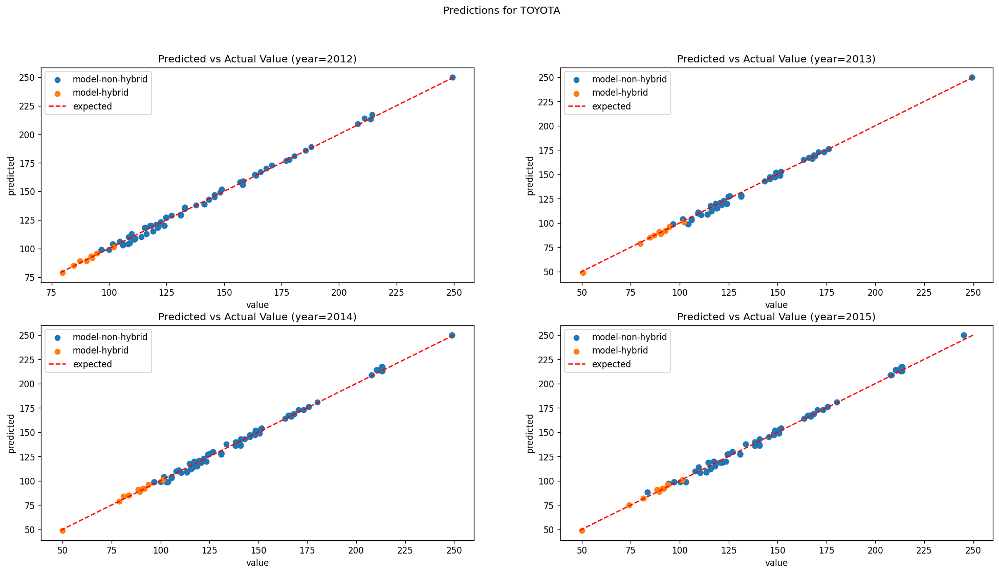

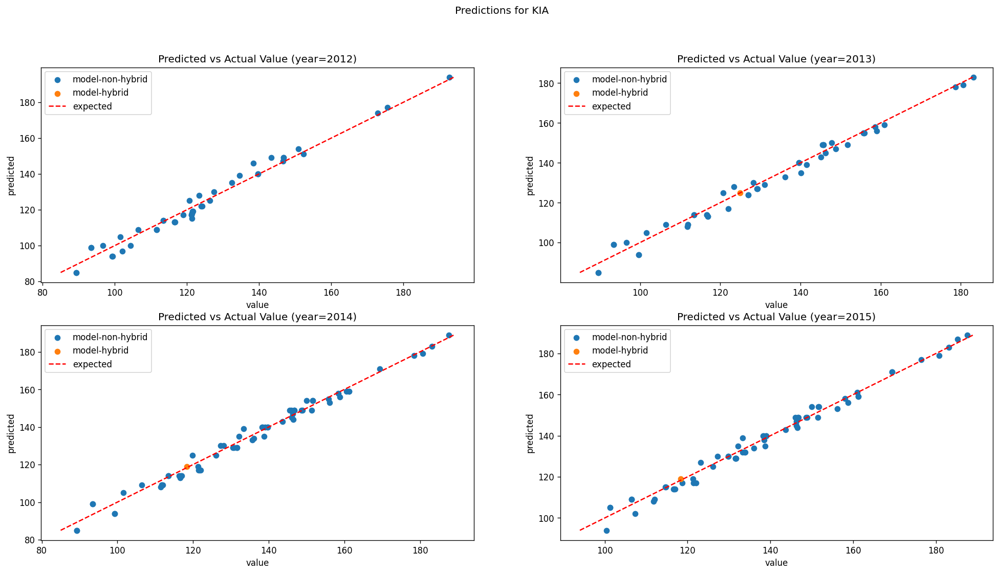

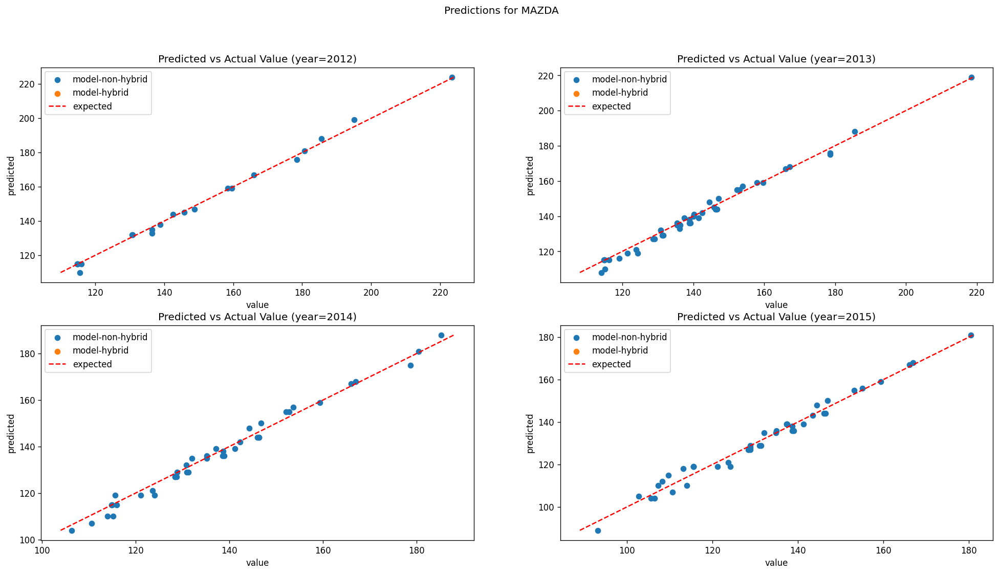

...

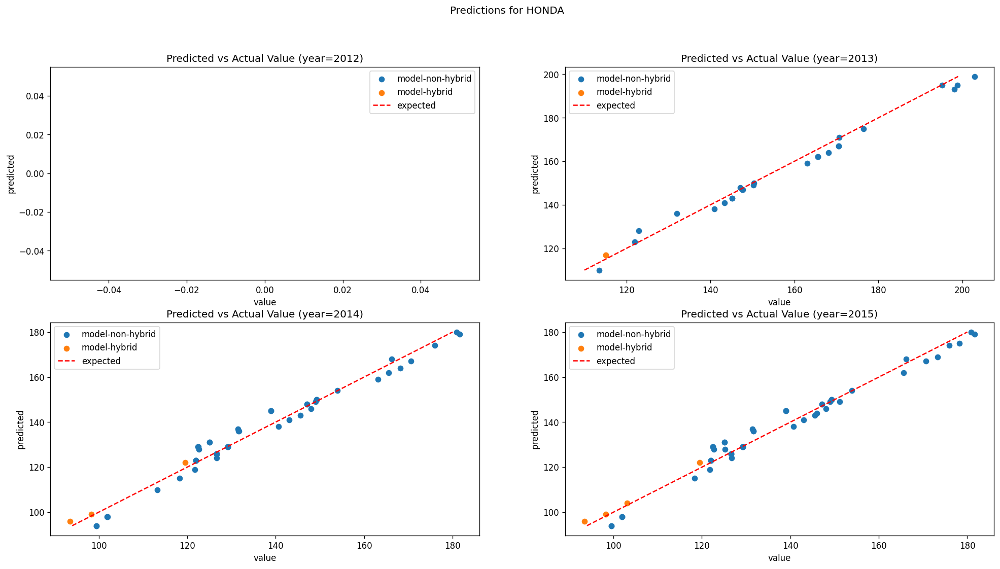

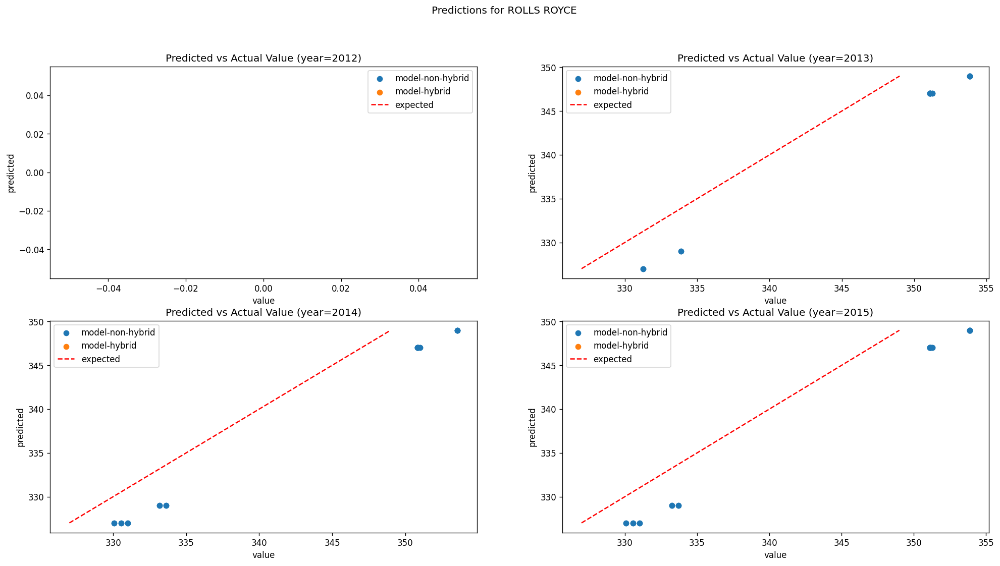

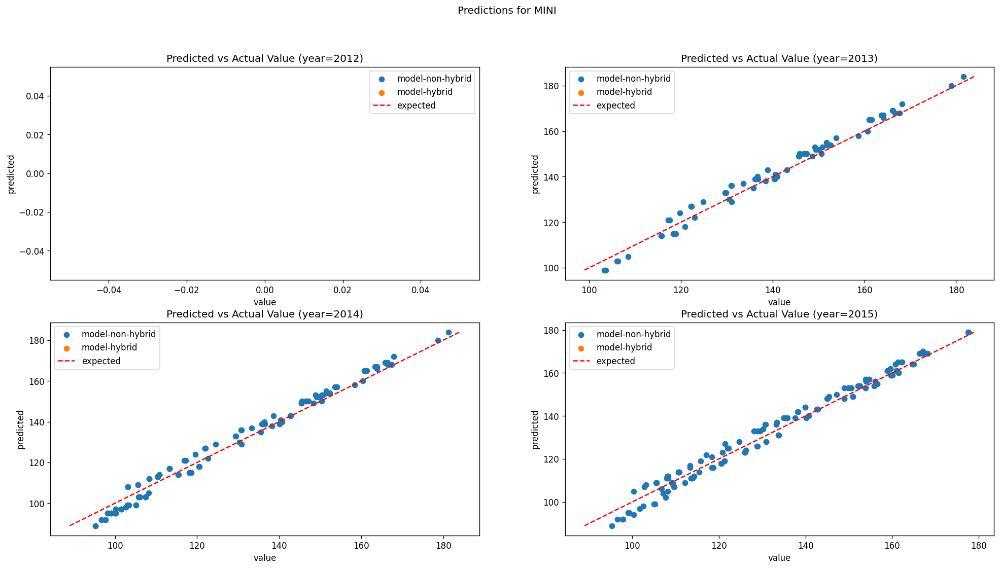

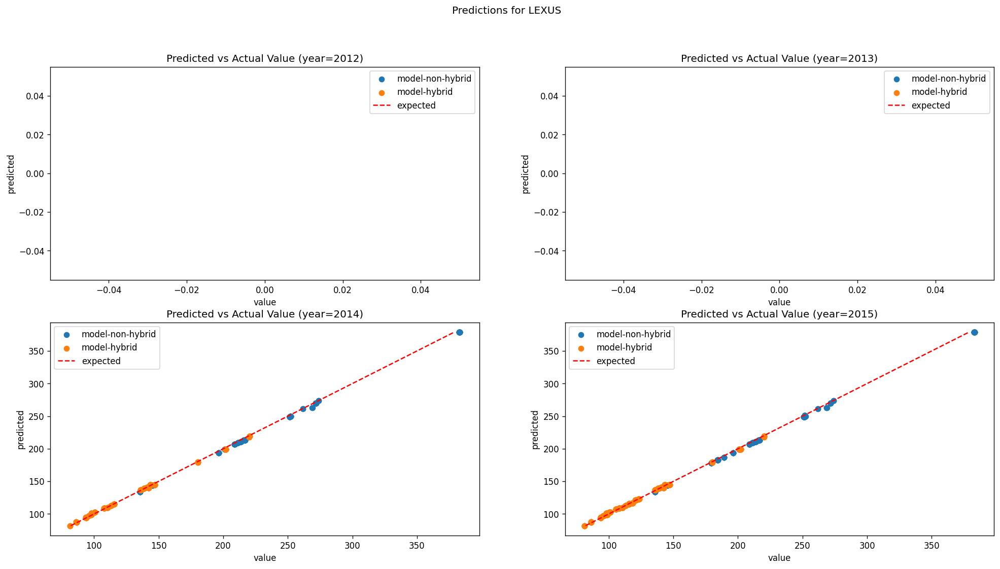

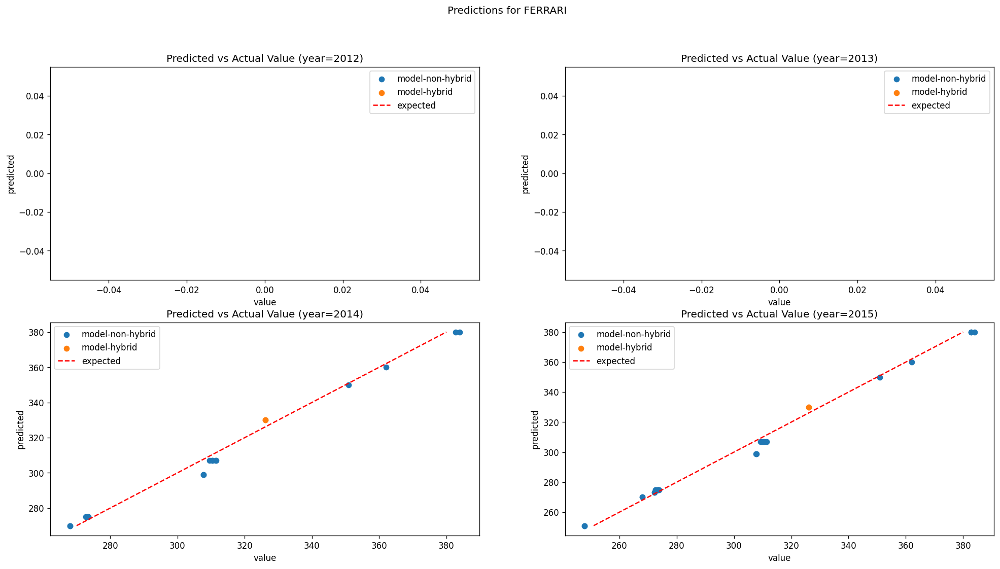

In [78]:
for brand in df.lib_mrq_utac.unique():
    plot_brand_per_year(brand, show_fig=False)

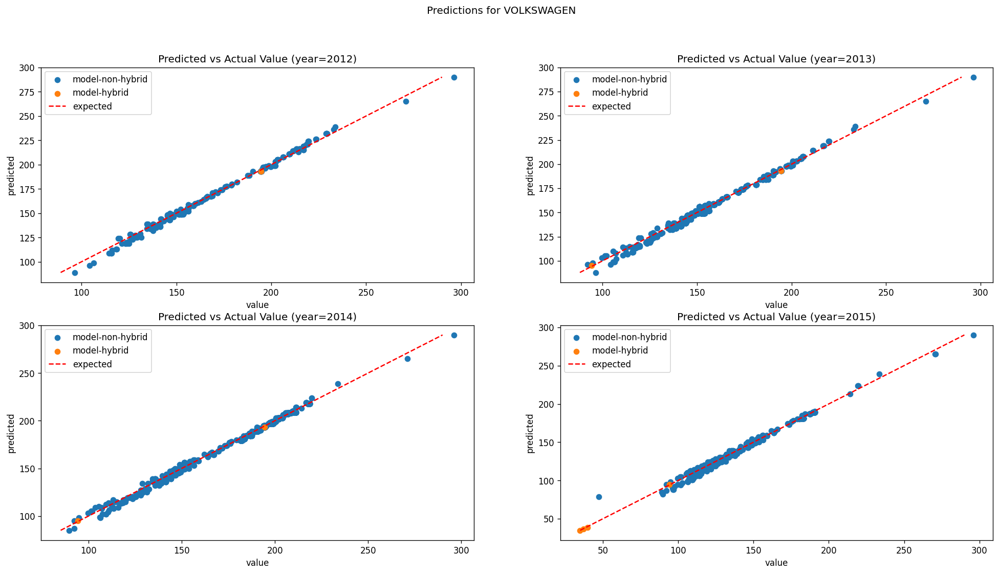

In [72]:
plot_brand_per_year('VOLKSWAGEN')

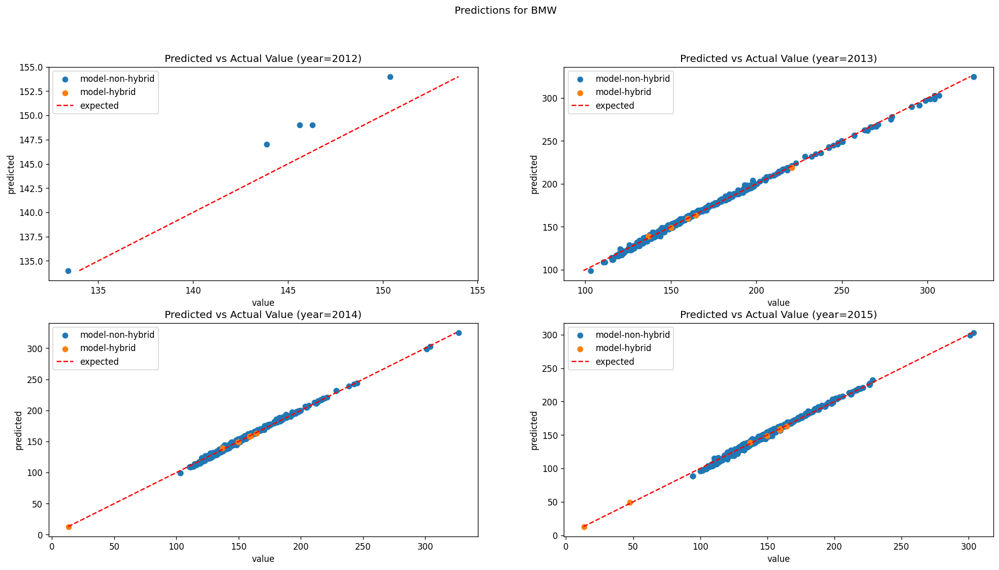

In [73]:
plot_brand_per_year('BMW')

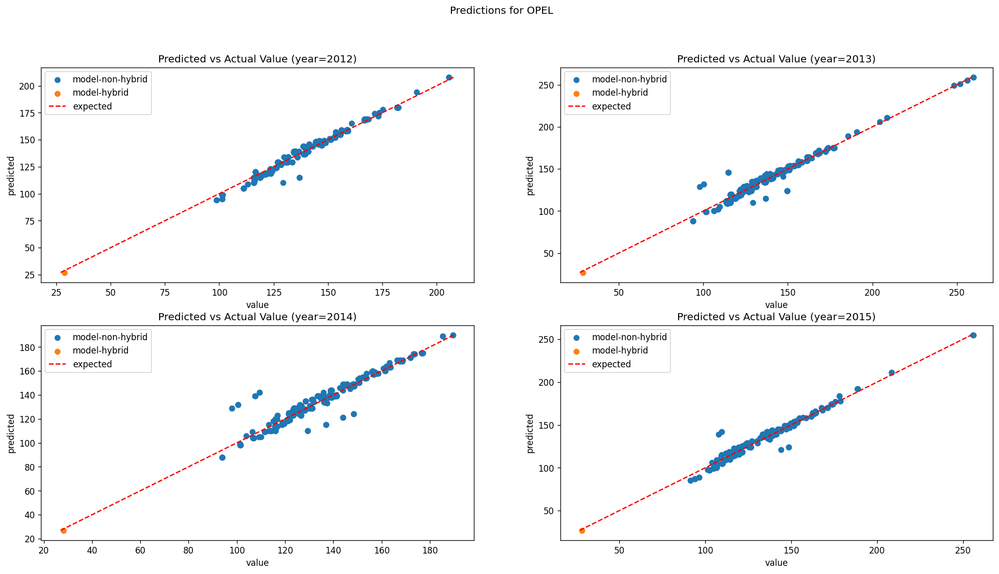

In [74]:
plot_brand_per_year('OPEL')

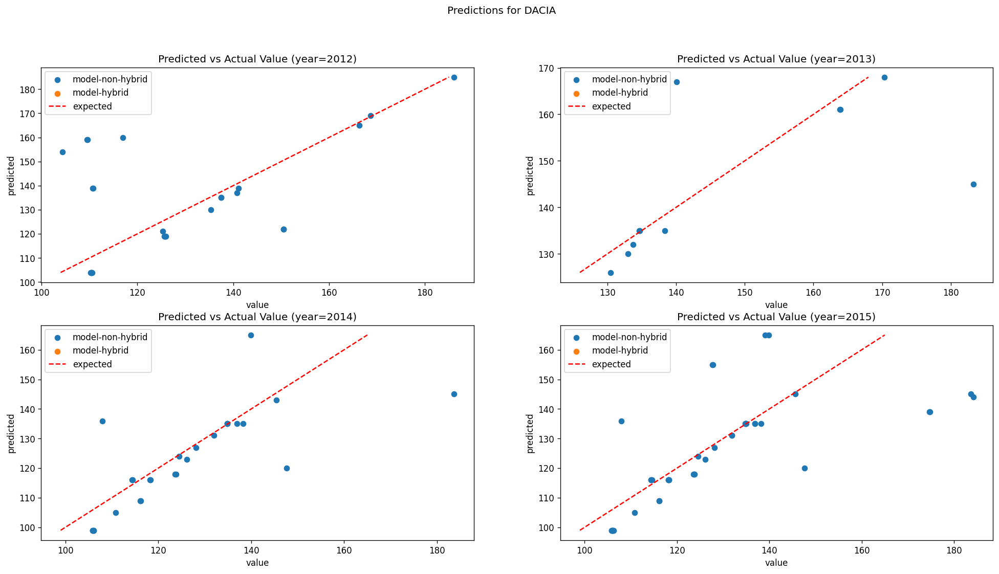

In [75]:
plot_brand_per_year('DACIA')

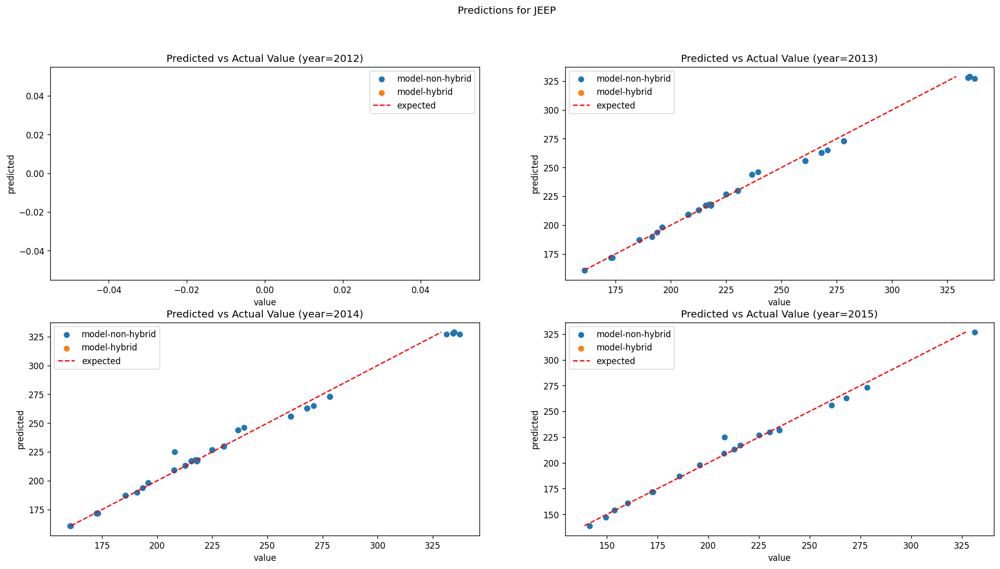

In [76]:
plot_brand_per_year('JEEP')